# Afriat

In [1]:
scan=0.1325

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2540,3299,9404
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2540,2571,1724,3398,1622,3388
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4445,10798
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 665,810,2335
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 665,631,384,892,427,811
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1139,2671
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:22:32, 14.28s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:22:32, 14.28s/it, v_num=1, total_loss_train=3.73e+3, kl_local_train=55.3]

Epoch 2/600:   0%|          | 1/600 [00:14<2:22:32, 14.28s/it, v_num=1, total_loss_train=3.73e+3, kl_local_train=55.3]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:33, 13.50s/it, v_num=1, total_loss_train=3.73e+3, kl_local_train=55.3]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:33, 13.50s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=83]  

Epoch 3/600:   0%|          | 2/600 [00:27<2:14:33, 13.50s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=83]

Epoch 3/600:   0%|          | 3/600 [00:40<2:11:35, 13.23s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=83]

Epoch 3/600:   0%|          | 3/600 [00:40<2:11:35, 13.23s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=84.9]

Epoch 4/600:   0%|          | 3/600 [00:40<2:11:35, 13.23s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=84.9]

Epoch 4/600:   1%|          | 4/600 [00:52<2:09:47, 13.07s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=84.9]

Epoch 4/600:   1%|          | 4/600 [00:52<2:09:47, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 4/600 [00:52<2:09:47, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:06<2:09:37, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:06<2:09:37, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=75.8]

Epoch 6/600:   1%|          | 5/600 [01:07<2:09:37, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=75.8]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:30, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=75.8]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:30, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:19<2:11:30, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:32<2:08:34, 13.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=66.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:32<2:08:34, 13.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:32<2:08:34, 13.01s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:27, 12.82s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:27, 12.82s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:44<2:06:27, 12.82s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:04:51, 12.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:04:51, 12.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [01:56<2:04:51, 12.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:09<2:04:07, 12.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:09<2:04:07, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349] 

Epoch 11/600:   2%|▏         | 10/600 [02:10<2:04:07, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:07:10, 12.95s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=27.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00744, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:07:10, 12.95s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 12/600:   2%|▏         | 11/600 [02:23<2:07:10, 12.95s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:12, 12.78s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=36.3, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:12, 12.78s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 13/600:   2%|▏         | 12/600 [02:35<2:05:12, 12.78s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:40, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:40, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 14/600:   2%|▏         | 13/600 [02:47<2:03:40, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 14/600:   2%|▏         | 14/600 [03:00<2:02:32, 12.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 14/600:   2%|▏         | 14/600 [03:00<2:02:32, 12.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 15/600:   2%|▏         | 14/600 [03:00<2:02:32, 12.55s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 15/600:   2%|▎         | 15/600 [03:12<2:02:07, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 15/600:   2%|▎         | 15/600 [03:12<2:02:07, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 16/600:   2%|▎         | 15/600 [03:14<2:02:07, 12.52s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:28, 12.89s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0233, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0174, metric_mi|mouse_train=0.0425]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:28, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 17/600:   3%|▎         | 16/600 [03:26<2:05:28, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:46, 12.74s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:46, 12.74s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 18/600:   3%|▎         | 17/600 [03:38<2:03:46, 12.74s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 18/600:   3%|▎         | 18/600 [03:51<2:02:28, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 18/600:   3%|▎         | 18/600 [03:51<2:02:28, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 19/600:   3%|▎         | 18/600 [03:51<2:02:28, 12.63s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 19/600:   3%|▎         | 19/600 [04:03<2:01:31, 12.55s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=71.3, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 19/600:   3%|▎         | 19/600 [04:03<2:01:31, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 20/600:   3%|▎         | 19/600 [04:03<2:01:31, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 20/600:   3%|▎         | 20/600 [04:16<2:01:16, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 20/600:   3%|▎         | 20/600 [04:16<2:01:16, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 21/600:   3%|▎         | 20/600 [04:17<2:01:16, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:04:31, 12.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0601]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:04:31, 12.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=94.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853] 

Epoch 22/600:   4%|▎         | 21/600 [04:29<2:04:31, 12.90s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=94.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:02:56, 12.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=94.6, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:02:56, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853] 

Epoch 23/600:   4%|▎         | 22/600 [04:42<2:02:56, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:01:45, 12.66s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:01:45, 12.66s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 24/600:   4%|▍         | 23/600 [04:54<2:01:45, 12.66s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 24/600:   4%|▍         | 24/600 [05:07<2:00:51, 12.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 24/600:   4%|▍         | 24/600 [05:07<2:00:51, 12.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 25/600:   4%|▍         | 24/600 [05:07<2:00:51, 12.59s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 25/600:   4%|▍         | 25/600 [05:20<2:01:52, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 25/600:   4%|▍         | 25/600 [05:20<2:01:52, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 26/600:   4%|▍         | 25/600 [05:21<2:01:52, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 26/600:   4%|▍         | 26/600 [05:33<2:04:42, 13.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.054, metric_mi|zone_train=0.0657, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0853]

Epoch 26/600:   4%|▍         | 26/600 [05:33<2:04:42, 13.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 26/600 [05:33<2:04:42, 13.04s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [05:46<2:03:19, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [05:46<2:03:19, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 28/600:   4%|▍         | 27/600 [05:46<2:03:19, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [05:59<2:02:09, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=120, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [05:59<2:02:09, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 28/600 [05:59<2:02:09, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [06:11<2:01:25, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [06:11<2:01:25, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▍         | 29/600 [06:11<2:01:25, 12.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [06:24<2:02:11, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [06:24<2:02:11, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 30/600 [06:26<2:02:11, 12.86s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [06:38<2:04:33, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0885, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.0998, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [06:38<2:04:33, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]  

Epoch 32/600:   5%|▌         | 31/600 [06:38<2:04:33, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [06:51<2:02:59, 12.99s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 32/600:   5%|▌         | 32/600 [06:51<2:02:59, 12.99s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 33/600:   5%|▌         | 32/600 [06:51<2:02:59, 12.99s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:03<2:01:48, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 33/600:   6%|▌         | 33/600 [07:03<2:01:48, 12.89s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 33/600 [07:03<2:01:48, 12.89s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:16<2:00:54, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 34/600:   6%|▌         | 34/600 [07:16<2:00:54, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 34/600 [07:16<2:00:54, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [07:29<2:00:42, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 35/600:   6%|▌         | 35/600 [07:29<2:00:42, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 35/600 [07:30<2:00:42, 12.82s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [07:43<2:04:39, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0984, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.114]

Epoch 36/600:   6%|▌         | 36/600 [07:43<2:04:39, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]   

Epoch 37/600:   6%|▌         | 36/600 [07:43<2:04:39, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 37/600:   6%|▌         | 37/600 [07:56<2:03:37, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 37/600:   6%|▌         | 37/600 [07:56<2:03:37, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▌         | 37/600 [07:56<2:03:37, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▋         | 38/600 [08:09<2:02:48, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 38/600:   6%|▋         | 38/600 [08:09<2:02:48, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 39/600:   6%|▋         | 38/600 [08:09<2:02:48, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 39/600:   6%|▋         | 39/600 [08:22<2:02:15, 13.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 39/600:   6%|▋         | 39/600 [08:22<2:02:15, 13.08s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117] 

Epoch 40/600:   6%|▋         | 39/600 [08:22<2:02:15, 13.08s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 40/600:   7%|▋         | 40/600 [08:35<2:02:09, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 40/600:   7%|▋         | 40/600 [08:35<2:02:09, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 40/600 [08:37<2:02:09, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 41/600 [08:49<2:03:54, 13.30s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.117]

Epoch 41/600:   7%|▋         | 41/600 [08:49<2:03:54, 13.30s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12] 

Epoch 42/600:   7%|▋         | 41/600 [08:49<2:03:54, 13.30s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 42/600:   7%|▋         | 42/600 [09:02<2:02:46, 13.20s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 42/600:   7%|▋         | 42/600 [09:02<2:02:46, 13.20s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 43/600:   7%|▋         | 42/600 [09:02<2:02:46, 13.20s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 43/600:   7%|▋         | 43/600 [09:15<2:01:58, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 43/600:   7%|▋         | 43/600 [09:15<2:01:58, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 43/600 [09:15<2:01:58, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 44/600 [09:28<2:01:07, 13.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 44/600:   7%|▋         | 44/600 [09:28<2:01:07, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 45/600:   7%|▋         | 44/600 [09:28<2:01:07, 13.07s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 45/600:   8%|▊         | 45/600 [09:41<2:01:03, 13.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 45/600:   8%|▊         | 45/600 [09:41<2:01:03, 13.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 45/600 [09:42<2:01:03, 13.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 46/600 [09:55<2:04:23, 13.47s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 46/600:   8%|▊         | 46/600 [09:55<2:04:23, 13.47s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 46/600 [09:55<2:04:23, 13.47s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 47/600 [10:08<2:02:52, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 47/600:   8%|▊         | 47/600 [10:08<2:02:52, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 47/600 [10:08<2:02:52, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 48/600 [10:22<2:02:12, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 48/600:   8%|▊         | 48/600 [10:22<2:02:12, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 48/600 [10:22<2:02:12, 13.28s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 49/600 [10:35<2:01:14, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 49/600:   8%|▊         | 49/600 [10:35<2:01:14, 13.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 49/600 [10:35<2:01:14, 13.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 50/600 [10:48<2:00:57, 13.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 50/600:   8%|▊         | 50/600 [10:48<2:00:57, 13.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 50/600 [10:49<2:00:57, 13.20s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 51/600 [11:02<2:03:21, 13.48s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=97.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.123]

Epoch 51/600:   8%|▊         | 51/600 [11:02<2:03:21, 13.48s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=94.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 52/600:   8%|▊         | 51/600 [11:02<2:03:21, 13.48s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=94.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 52/600:   9%|▊         | 52/600 [11:15<2:01:41, 13.32s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=94.9, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 52/600:   9%|▊         | 52/600 [11:15<2:01:41, 13.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 53/600:   9%|▊         | 52/600 [11:15<2:01:41, 13.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 53/600:   9%|▉         | 53/600 [11:28<2:00:28, 13.21s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 53/600:   9%|▉         | 53/600 [11:28<2:00:28, 13.21s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 54/600:   9%|▉         | 53/600 [11:28<2:00:28, 13.21s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 54/600:   9%|▉         | 54/600 [11:41<1:59:35, 13.14s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 54/600:   9%|▉         | 54/600 [11:41<1:59:35, 13.14s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 55/600:   9%|▉         | 54/600 [11:41<1:59:35, 13.14s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 55/600:   9%|▉         | 55/600 [11:54<1:59:14, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 55/600:   9%|▉         | 55/600 [11:54<1:59:14, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 56/600:   9%|▉         | 55/600 [11:55<1:59:14, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 56/600:   9%|▉         | 56/600 [12:08<2:01:12, 13.37s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 56/600:   9%|▉         | 56/600 [12:08<2:01:12, 13.37s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:   9%|▉         | 56/600 [12:08<2:01:12, 13.37s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:21<1:59:39, 13.22s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=92.7, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:21<1:59:39, 13.22s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 57/600 [12:21<1:59:39, 13.22s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:34<1:58:42, 13.14s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:34<1:58:42, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124] 

Epoch 59/600:  10%|▉         | 58/600 [12:34<1:58:42, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [12:47<1:57:59, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [12:47<1:57:59, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|▉         | 59/600 [12:47<1:57:59, 13.09s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [13:00<1:57:56, 13.10s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [13:00<1:57:56, 13.10s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 60/600 [13:01<1:57:56, 13.10s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [13:14<1:59:48, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [13:14<1:59:48, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 61/600 [13:14<1:59:48, 13.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:27<1:58:25, 13.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:27<1:58:25, 13.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 62/600 [13:27<1:58:25, 13.21s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:39<1:57:22, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:39<1:57:22, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  10%|█         | 63/600 [13:39<1:57:22, 13.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [13:52<1:56:45, 13.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=86.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [13:52<1:56:45, 13.07s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123] 

Epoch 65/600:  11%|█         | 64/600 [13:52<1:56:45, 13.07s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [14:05<1:55:57, 13.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [14:05<1:55:57, 13.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 65/600 [14:07<1:55:57, 13.01s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:20<1:59:07, 13.38s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:20<1:59:07, 13.38s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 66/600 [14:20<1:59:07, 13.38s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 67/600 [14:32<1:57:30, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 67/600 [14:32<1:57:30, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█         | 67/600 [14:32<1:57:30, 13.23s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█▏        | 68/600 [14:45<1:56:27, 13.14s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█▏        | 68/600 [14:45<1:56:27, 13.14s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  11%|█▏        | 68/600 [14:45<1:56:27, 13.14s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  12%|█▏        | 69/600 [14:58<1:55:45, 13.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  12%|█▏        | 69/600 [14:58<1:55:45, 13.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]  

Epoch 70/600:  12%|█▏        | 69/600 [14:58<1:55:45, 13.08s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 70/600:  12%|█▏        | 70/600 [15:12<1:56:00, 13.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 70/600:  12%|█▏        | 70/600 [15:12<1:56:00, 13.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 70/600 [15:13<1:56:00, 13.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 71/600 [15:26<1:58:14, 13.41s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 71/600 [15:26<1:58:14, 13.41s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|█▏        | 71/600 [15:26<1:58:14, 13.41s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|█▏        | 72/600 [15:38<1:55:51, 13.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 72/600:  12%|█▏        | 72/600 [15:38<1:55:51, 13.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|█▏        | 72/600 [15:38<1:55:51, 13.16s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|█▏        | 73/600 [15:51<1:54:13, 13.00s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 73/600:  12%|█▏        | 73/600 [15:51<1:54:13, 13.00s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|█▏        | 73/600 [15:51<1:54:13, 13.00s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|█▏        | 74/600 [16:03<1:53:01, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 74/600:  12%|█▏        | 74/600 [16:03<1:53:01, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|█▏        | 74/600 [16:03<1:53:01, 12.89s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|█▎        | 75/600 [16:17<1:53:30, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 75/600:  12%|█▎        | 75/600 [16:17<1:53:30, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 76/600:  12%|█▎        | 75/600 [16:18<1:53:30, 12.97s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 76/600:  13%|█▎        | 76/600 [16:30<1:55:41, 13.25s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.118]

Epoch 76/600:  13%|█▎        | 76/600 [16:30<1:55:41, 13.25s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|█▎        | 76/600 [16:30<1:55:41, 13.25s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|█▎        | 77/600 [16:43<1:53:57, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 77/600:  13%|█▎        | 77/600 [16:43<1:53:57, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|█▎        | 77/600 [16:43<1:53:57, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|█▎        | 78/600 [16:56<1:52:35, 12.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 78/600:  13%|█▎        | 78/600 [16:56<1:52:35, 12.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|█▎        | 78/600 [16:56<1:52:35, 12.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|█▎        | 79/600 [17:08<1:51:47, 12.87s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=77.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 79/600:  13%|█▎        | 79/600 [17:08<1:51:47, 12.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|█▎        | 79/600 [17:08<1:51:47, 12.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|█▎        | 80/600 [17:22<1:52:17, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 80/600:  13%|█▎        | 80/600 [17:22<1:52:17, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  13%|█▎        | 80/600 [17:23<1:52:17, 12.96s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|█▎        | 81/600 [17:35<1:54:24, 13.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 81/600:  14%|█▎        | 81/600 [17:35<1:54:24, 13.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 81/600 [17:35<1:54:24, 13.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 82/600 [17:48<1:52:26, 13.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 82/600 [17:48<1:52:26, 13.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▎        | 82/600 [17:48<1:52:26, 13.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▍        | 83/600 [18:01<1:51:00, 12.88s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▍        | 83/600 [18:01<1:51:00, 12.88s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 83/600 [18:01<1:51:00, 12.88s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 84/600 [18:13<1:50:11, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 84/600 [18:13<1:50:11, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 84/600 [18:13<1:50:11, 12.81s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 85/600 [18:26<1:50:50, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 85/600 [18:26<1:50:50, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 85/600 [18:28<1:50:50, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 86/600 [18:40<1:53:03, 13.20s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 86/600 [18:40<1:53:03, 13.20s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 86/600 [18:40<1:53:03, 13.20s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 87/600 [18:53<1:51:18, 13.02s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 87/600 [18:53<1:51:18, 13.02s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  14%|█▍        | 87/600 [18:53<1:51:18, 13.02s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  15%|█▍        | 88/600 [19:05<1:49:58, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  15%|█▍        | 88/600 [19:05<1:49:58, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 88/600 [19:05<1:49:58, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 89/600 [19:18<1:49:18, 12.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 89/600 [19:18<1:49:18, 12.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▍        | 89/600 [19:18<1:49:18, 12.84s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▌        | 90/600 [19:31<1:49:53, 12.93s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▌        | 90/600 [19:31<1:49:53, 12.93s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 90/600 [19:33<1:49:53, 12.93s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 91/600 [19:45<1:52:05, 13.21s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 91/600 [19:45<1:52:05, 13.21s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11] 

Epoch 92/600:  15%|█▌        | 91/600 [19:45<1:52:05, 13.21s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 92/600:  15%|█▌        | 92/600 [19:58<1:50:10, 13.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 92/600:  15%|█▌        | 92/600 [19:58<1:50:10, 13.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 93/600:  15%|█▌        | 92/600 [19:58<1:50:10, 13.01s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 93/600:  16%|█▌        | 93/600 [20:10<1:48:59, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 93/600:  16%|█▌        | 93/600 [20:10<1:48:59, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 93/600 [20:10<1:48:59, 12.90s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 94/600 [20:23<1:48:23, 12.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 94/600:  16%|█▌        | 94/600 [20:23<1:48:23, 12.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 94/600 [20:23<1:48:23, 12.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 95/600 [20:36<1:48:54, 12.94s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 95/600:  16%|█▌        | 95/600 [20:36<1:48:54, 12.94s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 95/600 [20:38<1:48:54, 12.94s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 96/600 [20:50<1:51:05, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 96/600:  16%|█▌        | 96/600 [20:50<1:51:05, 13.23s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 96/600 [20:50<1:51:05, 13.23s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:03<1:49:16, 13.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 97/600:  16%|█▌        | 97/600 [21:03<1:49:16, 13.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▌        | 97/600 [21:03<1:49:16, 13.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [21:15<1:47:52, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 98/600:  16%|█▋        | 98/600 [21:15<1:47:52, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 98/600 [21:15<1:47:52, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [21:28<1:46:48, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 99/600:  16%|█▋        | 99/600 [21:28<1:46:48, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 100/600:  16%|█▋        | 99/600 [21:28<1:46:48, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [21:41<1:47:38, 12.92s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 100/600:  17%|█▋        | 100/600 [21:41<1:47:38, 12.92s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 100/600 [21:42<1:47:38, 12.92s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [21:55<1:49:53, 13.21s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 101/600:  17%|█▋        | 101/600 [21:55<1:49:53, 13.21s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 101/600 [21:55<1:49:53, 13.21s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:08<1:48:03, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [22:08<1:48:03, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [22:08<1:48:03, 13.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:20<1:46:49, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:20<1:46:49, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [22:20<1:46:49, 12.90s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:33<1:45:44, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:33<1:45:44, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [22:33<1:45:44, 12.79s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:46<1:45:47, 12.82s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:46<1:45:47, 12.82s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]  

Epoch 106/600:  18%|█▊        | 105/600 [22:47<1:45:47, 12.82s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:59<1:48:10, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:59<1:48:10, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 106/600 [22:59<1:48:10, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 107/600 [23:12<1:46:34, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 107/600:  18%|█▊        | 107/600 [23:12<1:46:34, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 107/600 [23:12<1:46:34, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 108/600 [23:25<1:45:28, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 108/600:  18%|█▊        | 108/600 [23:25<1:45:28, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 109/600:  18%|█▊        | 108/600 [23:25<1:45:28, 12.86s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 109/600:  18%|█▊        | 109/600 [23:37<1:44:35, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 109/600:  18%|█▊        | 109/600 [23:37<1:44:35, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 109/600 [23:37<1:44:35, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 110/600 [23:50<1:44:44, 12.83s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 110/600:  18%|█▊        | 110/600 [23:50<1:44:44, 12.83s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 110/600 [23:52<1:44:44, 12.83s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 111/600 [24:04<1:47:05, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 111/600:  18%|█▊        | 111/600 [24:04<1:47:05, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  18%|█▊        | 111/600 [24:04<1:47:05, 13.14s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  19%|█▊        | 112/600 [24:17<1:45:26, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 112/600:  19%|█▊        | 112/600 [24:17<1:45:26, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▊        | 112/600 [24:17<1:45:26, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▉        | 113/600 [24:29<1:44:17, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 113/600:  19%|█▉        | 113/600 [24:29<1:44:17, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]  

Epoch 114/600:  19%|█▉        | 113/600 [24:29<1:44:17, 12.85s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 114/600:  19%|█▉        | 114/600 [24:42<1:43:29, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 114/600:  19%|█▉        | 114/600 [24:42<1:43:29, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 114/600 [24:42<1:43:29, 12.78s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 115/600 [24:55<1:44:16, 12.90s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=65.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 115/600:  19%|█▉        | 115/600 [24:55<1:44:16, 12.90s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 115/600 [24:56<1:44:16, 12.90s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 116/600 [25:09<1:46:29, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 116/600:  19%|█▉        | 116/600 [25:09<1:46:29, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107] 

Epoch 117/600:  19%|█▉        | 116/600 [25:09<1:46:29, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|█▉        | 117/600 [25:22<1:45:08, 13.06s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 117/600:  20%|█▉        | 117/600 [25:22<1:45:08, 13.06s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 117/600 [25:22<1:45:08, 13.06s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 118/600 [25:34<1:43:42, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 118/600:  20%|█▉        | 118/600 [25:34<1:43:42, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]  

Epoch 119/600:  20%|█▉        | 118/600 [25:34<1:43:42, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|█▉        | 119/600 [25:47<1:42:37, 12.80s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 119/600:  20%|█▉        | 119/600 [25:47<1:42:37, 12.80s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|█▉        | 119/600 [25:47<1:42:37, 12.80s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|██        | 120/600 [26:00<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 120/600:  20%|██        | 120/600 [26:00<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 120/600 [26:01<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 121/600 [26:14<1:45:22, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 121/600:  20%|██        | 121/600 [26:14<1:45:22, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 121/600 [26:14<1:45:22, 13.20s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 122/600 [26:26<1:43:35, 13.00s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 122/600:  20%|██        | 122/600 [26:26<1:43:35, 13.00s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 122/600 [26:26<1:43:35, 13.00s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 123/600 [26:39<1:42:15, 12.86s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 123/600:  20%|██        | 123/600 [26:39<1:42:15, 12.86s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  20%|██        | 123/600 [26:39<1:42:15, 12.86s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|██        | 124/600 [26:51<1:41:17, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 124/600:  21%|██        | 124/600 [26:51<1:41:17, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 124/600 [26:51<1:41:17, 12.77s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 125/600 [27:05<1:42:04, 12.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 125/600:  21%|██        | 125/600 [27:05<1:42:04, 12.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 125/600 [27:06<1:42:04, 12.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 126/600 [27:18<1:44:07, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 126/600:  21%|██        | 126/600 [27:18<1:44:07, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 126/600 [27:18<1:44:07, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [27:31<1:42:22, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [27:31<1:42:22, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██        | 127/600 [27:31<1:42:22, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [27:43<1:41:05, 12.85s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [27:43<1:41:05, 12.85s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 129/600:  21%|██▏       | 128/600 [27:43<1:41:05, 12.85s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [27:56<1:40:09, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [27:56<1:40:09, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 129/600 [27:56<1:40:09, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [28:09<1:40:57, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [28:09<1:40:57, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 130/600 [28:11<1:40:57, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [28:23<1:43:06, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [28:23<1:43:06, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105] 

Epoch 132/600:  22%|██▏       | 131/600 [28:23<1:43:06, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [28:36<1:41:23, 13.00s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [28:36<1:41:23, 13.00s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 132/600 [28:36<1:41:23, 13.00s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [28:48<1:40:06, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [28:48<1:40:06, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 133/600 [28:48<1:40:06, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [29:01<1:39:08, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [29:01<1:39:08, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▏       | 134/600 [29:01<1:39:08, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [29:14<1:39:54, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [29:14<1:39:54, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  22%|██▎       | 135/600 [29:15<1:39:54, 12.89s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [29:28<1:41:58, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [29:28<1:41:58, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 136/600 [29:28<1:41:58, 13.19s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [29:40<1:40:15, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [29:40<1:40:15, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 137/600 [29:40<1:40:15, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [29:53<1:39:00, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [29:53<1:39:00, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]  

Epoch 139/600:  23%|██▎       | 138/600 [29:53<1:39:00, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:05<1:38:07, 12.77s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:05<1:38:07, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 139/600 [30:05<1:38:07, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [30:19<1:38:51, 12.90s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [30:19<1:38:51, 12.90s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 141/600:  23%|██▎       | 140/600 [30:20<1:38:51, 12.90s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [30:33<1:41:06, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [30:33<1:41:06, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 142/600:  24%|██▎       | 141/600 [30:33<1:41:06, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 142/600:  24%|██▎       | 142/600 [30:45<1:39:22, 13.02s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 142/600:  24%|██▎       | 142/600 [30:45<1:39:22, 13.02s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 143/600:  24%|██▎       | 142/600 [30:45<1:39:22, 13.02s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 143/600:  24%|██▍       | 143/600 [30:58<1:38:06, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 143/600:  24%|██▍       | 143/600 [30:58<1:38:06, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 144/600:  24%|██▍       | 143/600 [30:58<1:38:06, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 144/600:  24%|██▍       | 144/600 [31:10<1:37:07, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 144/600:  24%|██▍       | 144/600 [31:10<1:37:07, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 145/600:  24%|██▍       | 144/600 [31:10<1:37:07, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 145/600:  24%|██▍       | 145/600 [31:23<1:37:34, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 145/600:  24%|██▍       | 145/600 [31:23<1:37:34, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 146/600:  24%|██▍       | 145/600 [31:25<1:37:34, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 146/600:  24%|██▍       | 146/600 [31:37<1:39:41, 13.17s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0961, metric_mi|mouse_train=0.0997]

Epoch 146/600:  24%|██▍       | 146/600 [31:37<1:39:41, 13.17s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979] 

Epoch 147/600:  24%|██▍       | 146/600 [31:37<1:39:41, 13.17s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 147/600:  24%|██▍       | 147/600 [31:50<1:38:03, 12.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 147/600:  24%|██▍       | 147/600 [31:50<1:38:03, 12.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 148/600:  24%|██▍       | 147/600 [31:50<1:38:03, 12.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 148/600:  25%|██▍       | 148/600 [32:02<1:36:51, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 148/600:  25%|██▍       | 148/600 [32:02<1:36:51, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 149/600:  25%|██▍       | 148/600 [32:02<1:36:51, 12.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 149/600:  25%|██▍       | 149/600 [32:15<1:35:57, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 149/600:  25%|██▍       | 149/600 [32:15<1:35:57, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 150/600:  25%|██▍       | 149/600 [32:15<1:35:57, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 150/600:  25%|██▌       | 150/600 [32:28<1:36:34, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 150/600:  25%|██▌       | 150/600 [32:28<1:36:34, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 151/600:  25%|██▌       | 150/600 [32:29<1:36:34, 12.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 151/600:  25%|██▌       | 151/600 [32:42<1:38:36, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0979]

Epoch 151/600:  25%|██▌       | 151/600 [32:42<1:38:36, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 152/600:  25%|██▌       | 151/600 [32:42<1:38:36, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 152/600:  25%|██▌       | 152/600 [32:54<1:36:58, 12.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 152/600:  25%|██▌       | 152/600 [32:54<1:36:58, 12.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964] 

Epoch 153/600:  25%|██▌       | 152/600 [32:54<1:36:58, 12.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 153/600:  26%|██▌       | 153/600 [33:07<1:35:47, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 153/600:  26%|██▌       | 153/600 [33:07<1:35:47, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 153/600 [33:07<1:35:47, 12.86s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 154/600 [33:20<1:34:53, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 154/600 [33:20<1:34:53, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 154/600 [33:20<1:34:53, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 155/600 [33:33<1:35:15, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 155/600 [33:33<1:35:15, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 155/600 [33:34<1:35:15, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 156/600 [33:46<1:37:22, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 156/600 [33:46<1:37:22, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954] 

Epoch 157/600:  26%|██▌       | 156/600 [33:46<1:37:22, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 157/600:  26%|██▌       | 157/600 [33:59<1:35:46, 12.97s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 157/600:  26%|██▌       | 157/600 [33:59<1:35:46, 12.97s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]  

Epoch 158/600:  26%|██▌       | 157/600 [33:59<1:35:46, 12.97s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 158/600:  26%|██▋       | 158/600 [34:12<1:34:35, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 158/600:  26%|██▋       | 158/600 [34:12<1:34:35, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 159/600:  26%|██▋       | 158/600 [34:12<1:34:35, 12.84s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 159/600:  26%|██▋       | 159/600 [34:24<1:33:42, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 159/600:  26%|██▋       | 159/600 [34:24<1:33:42, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 160/600:  26%|██▋       | 159/600 [34:24<1:33:42, 12.75s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 160/600:  27%|██▋       | 160/600 [34:37<1:34:13, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 160/600:  27%|██▋       | 160/600 [34:37<1:34:13, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 161/600:  27%|██▋       | 160/600 [34:39<1:34:13, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 161/600:  27%|██▋       | 161/600 [34:51<1:36:18, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0954]

Epoch 161/600:  27%|██▋       | 161/600 [34:51<1:36:18, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 162/600:  27%|██▋       | 161/600 [34:51<1:36:18, 13.16s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 162/600:  27%|██▋       | 162/600 [35:04<1:34:45, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 162/600:  27%|██▋       | 162/600 [35:04<1:34:45, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 163/600:  27%|██▋       | 162/600 [35:04<1:34:45, 12.98s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 163/600:  27%|██▋       | 163/600 [35:16<1:33:36, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 163/600:  27%|██▋       | 163/600 [35:16<1:33:36, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 164/600:  27%|██▋       | 163/600 [35:16<1:33:36, 12.85s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 164/600:  27%|██▋       | 164/600 [35:29<1:32:47, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 164/600:  27%|██▋       | 164/600 [35:29<1:32:47, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 165/600:  27%|██▋       | 164/600 [35:29<1:32:47, 12.77s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 165/600:  28%|██▊       | 165/600 [35:42<1:33:38, 12.92s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 165/600:  28%|██▊       | 165/600 [35:42<1:33:38, 12.92s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 166/600:  28%|██▊       | 165/600 [35:43<1:33:38, 12.92s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 166/600:  28%|██▊       | 166/600 [35:56<1:35:34, 13.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0945]

Epoch 166/600:  28%|██▊       | 166/600 [35:56<1:35:34, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]  

Epoch 167/600:  28%|██▊       | 166/600 [35:56<1:35:34, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 167/600:  28%|██▊       | 167/600 [36:08<1:33:59, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 167/600:  28%|██▊       | 167/600 [36:08<1:33:59, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 168/600:  28%|██▊       | 167/600 [36:08<1:33:59, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 168/600:  28%|██▊       | 168/600 [36:21<1:32:43, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 168/600:  28%|██▊       | 168/600 [36:21<1:32:43, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 169/600:  28%|██▊       | 168/600 [36:21<1:32:43, 12.88s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 169/600:  28%|██▊       | 169/600 [36:34<1:31:46, 12.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 169/600:  28%|██▊       | 169/600 [36:34<1:31:46, 12.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 170/600:  28%|██▊       | 169/600 [36:34<1:31:46, 12.78s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 170/600:  28%|██▊       | 170/600 [36:46<1:31:03, 12.71s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 170/600:  28%|██▊       | 170/600 [36:46<1:31:03, 12.71s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 171/600:  28%|██▊       | 170/600 [36:47<1:31:03, 12.71s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 171/600:  28%|██▊       | 171/600 [37:00<1:33:22, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.094]

Epoch 171/600:  28%|██▊       | 171/600 [37:00<1:33:22, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 172/600:  28%|██▊       | 171/600 [37:00<1:33:22, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 172/600:  29%|██▊       | 172/600 [37:13<1:32:02, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 172/600:  29%|██▊       | 172/600 [37:13<1:32:02, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 173/600:  29%|██▊       | 172/600 [37:13<1:32:02, 12.90s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 173/600:  29%|██▉       | 173/600 [37:25<1:31:03, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 173/600:  29%|██▉       | 173/600 [37:25<1:31:03, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 174/600:  29%|██▉       | 173/600 [37:25<1:31:03, 12.80s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 174/600:  29%|██▉       | 174/600 [37:38<1:30:18, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 174/600:  29%|██▉       | 174/600 [37:38<1:30:18, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 175/600:  29%|██▉       | 174/600 [37:38<1:30:18, 12.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 175/600:  29%|██▉       | 175/600 [37:51<1:31:01, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 175/600:  29%|██▉       | 175/600 [37:51<1:31:01, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 176/600:  29%|██▉       | 175/600 [37:52<1:31:01, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 176/600:  29%|██▉       | 176/600 [38:05<1:32:57, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.099, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0925]

Epoch 176/600:  29%|██▉       | 176/600 [38:05<1:32:57, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 177/600:  29%|██▉       | 176/600 [38:05<1:32:57, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 177/600:  30%|██▉       | 177/600 [38:17<1:31:27, 12.97s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 177/600:  30%|██▉       | 177/600 [38:17<1:31:27, 12.97s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 177/600 [38:17<1:31:27, 12.97s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 178/600 [38:30<1:30:21, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 178/600:  30%|██▉       | 178/600 [38:30<1:30:21, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 178/600 [38:30<1:30:21, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 179/600 [38:42<1:29:28, 12.75s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 179/600:  30%|██▉       | 179/600 [38:42<1:29:28, 12.75s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|██▉       | 179/600 [38:42<1:29:28, 12.75s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|███       | 180/600 [38:55<1:29:56, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 180/600:  30%|███       | 180/600 [38:55<1:29:56, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 180/600 [38:57<1:29:56, 12.85s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 181/600 [39:09<1:31:51, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.092]

Epoch 181/600:  30%|███       | 181/600 [39:09<1:31:51, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 182/600:  30%|███       | 181/600 [39:09<1:31:51, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 182/600:  30%|███       | 182/600 [39:22<1:30:23, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 182/600:  30%|███       | 182/600 [39:22<1:30:23, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]  

Epoch 183/600:  30%|███       | 182/600 [39:22<1:30:23, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 183/600:  30%|███       | 183/600 [39:34<1:29:22, 12.86s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 183/600:  30%|███       | 183/600 [39:34<1:29:22, 12.86s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 184/600:  30%|███       | 183/600 [39:34<1:29:22, 12.86s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 184/600:  31%|███       | 184/600 [39:47<1:28:31, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 184/600:  31%|███       | 184/600 [39:47<1:28:31, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 185/600:  31%|███       | 184/600 [39:47<1:28:31, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 185/600:  31%|███       | 185/600 [39:59<1:27:48, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 185/600:  31%|███       | 185/600 [39:59<1:27:48, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 186/600:  31%|███       | 185/600 [40:01<1:27:48, 12.70s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 186/600:  31%|███       | 186/600 [40:13<1:30:05, 13.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.091]

Epoch 186/600:  31%|███       | 186/600 [40:13<1:30:05, 13.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 187/600:  31%|███       | 186/600 [40:13<1:30:05, 13.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 187/600:  31%|███       | 187/600 [40:26<1:28:50, 12.91s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 187/600:  31%|███       | 187/600 [40:26<1:28:50, 12.91s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 188/600:  31%|███       | 187/600 [40:26<1:28:50, 12.91s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 188/600:  31%|███▏      | 188/600 [40:38<1:27:58, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 188/600:  31%|███▏      | 188/600 [40:38<1:27:58, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 189/600:  31%|███▏      | 188/600 [40:38<1:27:58, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 189/600:  32%|███▏      | 189/600 [40:51<1:27:27, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 189/600:  32%|███▏      | 189/600 [40:51<1:27:27, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 190/600:  32%|███▏      | 189/600 [40:51<1:27:27, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 190/600:  32%|███▏      | 190/600 [41:04<1:27:55, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 190/600:  32%|███▏      | 190/600 [41:04<1:27:55, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 191/600:  32%|███▏      | 190/600 [41:06<1:27:55, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 191/600:  32%|███▏      | 191/600 [41:18<1:29:44, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0958, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0906]

Epoch 191/600:  32%|███▏      | 191/600 [41:18<1:29:44, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895] 

Epoch 192/600:  32%|███▏      | 191/600 [41:18<1:29:44, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 192/600:  32%|███▏      | 192/600 [41:31<1:28:14, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 192/600:  32%|███▏      | 192/600 [41:31<1:28:14, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 193/600:  32%|███▏      | 192/600 [41:31<1:28:14, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 193/600:  32%|███▏      | 193/600 [41:43<1:27:07, 12.84s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 193/600:  32%|███▏      | 193/600 [41:43<1:27:07, 12.84s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 194/600:  32%|███▏      | 193/600 [41:43<1:27:07, 12.84s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 194/600:  32%|███▏      | 194/600 [41:56<1:26:23, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 194/600:  32%|███▏      | 194/600 [41:56<1:26:23, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]  

Epoch 195/600:  32%|███▏      | 194/600 [41:56<1:26:23, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 195/600:  32%|███▎      | 195/600 [42:09<1:27:01, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 195/600:  32%|███▎      | 195/600 [42:09<1:27:01, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 196/600:  32%|███▎      | 195/600 [42:10<1:27:01, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 196/600:  33%|███▎      | 196/600 [42:23<1:28:46, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0895]

Epoch 196/600:  33%|███▎      | 196/600 [42:23<1:28:46, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 197/600:  33%|███▎      | 196/600 [42:23<1:28:46, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 197/600:  33%|███▎      | 197/600 [42:35<1:27:14, 12.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 197/600:  33%|███▎      | 197/600 [42:35<1:27:14, 12.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 198/600:  33%|███▎      | 197/600 [42:35<1:27:14, 12.99s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 198/600:  33%|███▎      | 198/600 [42:48<1:26:07, 12.85s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 198/600:  33%|███▎      | 198/600 [42:48<1:26:07, 12.85s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 199/600:  33%|███▎      | 198/600 [42:48<1:26:07, 12.85s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 199/600:  33%|███▎      | 199/600 [43:00<1:25:15, 12.76s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 199/600:  33%|███▎      | 199/600 [43:00<1:25:15, 12.76s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 200/600:  33%|███▎      | 199/600 [43:00<1:25:15, 12.76s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 200/600:  33%|███▎      | 200/600 [43:13<1:25:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 200/600:  33%|███▎      | 200/600 [43:13<1:25:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 201/600:  33%|███▎      | 200/600 [43:15<1:25:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 201/600:  34%|███▎      | 201/600 [43:27<1:27:08, 13.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0787, metric_mi|mouse_train=0.0886]

Epoch 201/600:  34%|███▎      | 201/600 [43:27<1:27:08, 13.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 201/600 [43:27<1:27:08, 13.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 202/600 [43:40<1:25:50, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 202/600:  34%|███▎      | 202/600 [43:40<1:25:50, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▎      | 202/600 [43:40<1:25:50, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▍      | 203/600 [43:52<1:24:48, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 203/600:  34%|███▍      | 203/600 [43:52<1:24:48, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 203/600 [43:52<1:24:48, 12.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 204/600 [44:05<1:24:00, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 204/600:  34%|███▍      | 204/600 [44:05<1:24:00, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 204/600 [44:05<1:24:00, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 205/600 [44:18<1:24:37, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 205/600:  34%|███▍      | 205/600 [44:18<1:24:37, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 205/600 [44:19<1:24:37, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 206/600 [44:32<1:26:25, 13.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0931, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0875]

Epoch 206/600:  34%|███▍      | 206/600 [44:32<1:26:25, 13.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086] 

Epoch 207/600:  34%|███▍      | 206/600 [44:32<1:26:25, 13.16s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 207/600:  34%|███▍      | 207/600 [44:44<1:25:03, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 207/600:  34%|███▍      | 207/600 [44:44<1:25:03, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 208/600:  34%|███▍      | 207/600 [44:44<1:25:03, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 208/600:  35%|███▍      | 208/600 [44:57<1:23:58, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 208/600:  35%|███▍      | 208/600 [44:57<1:23:58, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 209/600:  35%|███▍      | 208/600 [44:57<1:23:58, 12.85s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 209/600:  35%|███▍      | 209/600 [45:09<1:23:09, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 209/600:  35%|███▍      | 209/600 [45:09<1:23:09, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 210/600:  35%|███▍      | 209/600 [45:09<1:23:09, 12.76s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 210/600:  35%|███▌      | 210/600 [45:23<1:23:44, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 210/600:  35%|███▌      | 210/600 [45:23<1:23:44, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 211/600:  35%|███▌      | 210/600 [45:24<1:23:44, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 211/600:  35%|███▌      | 211/600 [45:36<1:25:30, 13.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0746, metric_mi|mouse_train=0.086]

Epoch 211/600:  35%|███▌      | 211/600 [45:36<1:25:30, 13.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 212/600:  35%|███▌      | 211/600 [45:36<1:25:30, 13.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 212/600:  35%|███▌      | 212/600 [45:49<1:24:23, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 212/600:  35%|███▌      | 212/600 [45:49<1:24:23, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 213/600:  35%|███▌      | 212/600 [45:49<1:24:23, 13.05s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:23:16, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:23:16, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 214/600:  36%|███▌      | 213/600 [46:02<1:23:16, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 214/600:  36%|███▌      | 214/600 [46:14<1:22:23, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 214/600:  36%|███▌      | 214/600 [46:14<1:22:23, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]  

Epoch 215/600:  36%|███▌      | 214/600 [46:14<1:22:23, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 215/600:  36%|███▌      | 215/600 [46:28<1:22:53, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 215/600:  36%|███▌      | 215/600 [46:28<1:22:53, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 216/600:  36%|███▌      | 215/600 [46:29<1:22:53, 12.92s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:24:33, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0736, metric_mi|mouse_train=0.0854]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:24:33, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 217/600:  36%|███▌      | 216/600 [46:41<1:24:33, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 217/600:  36%|███▌      | 217/600 [46:54<1:23:06, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 217/600:  36%|███▌      | 217/600 [46:54<1:23:06, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 218/600:  36%|███▌      | 217/600 [46:54<1:23:06, 13.02s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 218/600:  36%|███▋      | 218/600 [47:07<1:22:03, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 218/600:  36%|███▋      | 218/600 [47:07<1:22:03, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 219/600:  36%|███▋      | 218/600 [47:07<1:22:03, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 219/600:  36%|███▋      | 219/600 [47:19<1:21:14, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 219/600:  36%|███▋      | 219/600 [47:19<1:21:14, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 220/600:  36%|███▋      | 219/600 [47:19<1:21:14, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 220/600:  37%|███▋      | 220/600 [47:32<1:20:31, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 220/600:  37%|███▋      | 220/600 [47:32<1:20:31, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 221/600:  37%|███▋      | 220/600 [47:33<1:20:31, 12.71s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 221/600:  37%|███▋      | 221/600 [47:46<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0849]

Epoch 221/600:  37%|███▋      | 221/600 [47:46<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843] 

Epoch 222/600:  37%|███▋      | 221/600 [47:46<1:22:29, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 222/600:  37%|███▋      | 222/600 [47:58<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 222/600:  37%|███▋      | 222/600 [47:58<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 223/600:  37%|███▋      | 222/600 [47:58<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 223/600:  37%|███▋      | 223/600 [48:11<1:20:27, 12.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 223/600:  37%|███▋      | 223/600 [48:11<1:20:27, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 224/600:  37%|███▋      | 223/600 [48:11<1:20:27, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 224/600:  37%|███▋      | 224/600 [48:23<1:19:47, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 224/600:  37%|███▋      | 224/600 [48:23<1:19:47, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 225/600:  37%|███▋      | 224/600 [48:23<1:19:47, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 225/600:  38%|███▊      | 225/600 [48:36<1:19:20, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 225/600:  38%|███▊      | 225/600 [48:36<1:19:20, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 226/600:  38%|███▊      | 225/600 [48:37<1:19:20, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 226/600:  38%|███▊      | 226/600 [48:50<1:21:19, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.072, metric_mi|mouse_train=0.0843]

Epoch 226/600:  38%|███▊      | 226/600 [48:50<1:21:19, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 226/600 [48:50<1:21:19, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 227/600 [49:02<1:20:11, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 227/600:  38%|███▊      | 227/600 [49:02<1:20:11, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 227/600 [49:02<1:20:11, 12.90s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 228/600 [49:15<1:19:20, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 228/600:  38%|███▊      | 228/600 [49:15<1:19:20, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]  

Epoch 229/600:  38%|███▊      | 228/600 [49:15<1:19:20, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 229/600:  38%|███▊      | 229/600 [49:27<1:18:41, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 229/600:  38%|███▊      | 229/600 [49:27<1:18:41, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 229/600 [49:27<1:18:41, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 230/600 [49:41<1:19:16, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 230/600:  38%|███▊      | 230/600 [49:41<1:19:16, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 230/600 [49:42<1:19:16, 12.86s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 231/600 [49:55<1:21:07, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0929, metric_mi|zone_train=0.0864, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0835]

Epoch 231/600:  38%|███▊      | 231/600 [49:55<1:21:07, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 232/600:  38%|███▊      | 231/600 [49:55<1:21:07, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 232/600:  39%|███▊      | 232/600 [50:07<1:19:34, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 232/600:  39%|███▊      | 232/600 [50:07<1:19:34, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 233/600:  39%|███▊      | 232/600 [50:07<1:19:34, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 233/600:  39%|███▉      | 233/600 [50:19<1:18:01, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 233/600:  39%|███▉      | 233/600 [50:19<1:18:01, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 234/600:  39%|███▉      | 233/600 [50:19<1:18:01, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 234/600:  39%|███▉      | 234/600 [50:31<1:16:51, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 234/600:  39%|███▉      | 234/600 [50:31<1:16:51, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 235/600:  39%|███▉      | 234/600 [50:31<1:16:51, 12.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 235/600:  39%|███▉      | 235/600 [50:44<1:17:11, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 235/600:  39%|███▉      | 235/600 [50:44<1:17:11, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 236/600:  39%|███▉      | 235/600 [50:46<1:17:11, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 236/600:  39%|███▉      | 236/600 [51:00<1:22:30, 13.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0705, metric_mi|mouse_train=0.0836]

Epoch 236/600:  39%|███▉      | 236/600 [51:00<1:22:30, 13.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 237/600:  39%|███▉      | 236/600 [51:00<1:22:30, 13.60s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 237/600:  40%|███▉      | 237/600 [51:14<1:23:42, 13.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 237/600:  40%|███▉      | 237/600 [51:14<1:23:42, 13.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 238/600:  40%|███▉      | 237/600 [51:14<1:23:42, 13.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 238/600:  40%|███▉      | 238/600 [51:29<1:24:27, 14.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 238/600:  40%|███▉      | 238/600 [51:29<1:24:27, 14.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 239/600:  40%|███▉      | 238/600 [51:29<1:24:27, 14.00s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 239/600:  40%|███▉      | 239/600 [51:43<1:24:56, 14.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 239/600:  40%|███▉      | 239/600 [51:43<1:24:56, 14.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 240/600:  40%|███▉      | 239/600 [51:43<1:24:56, 14.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 240/600:  40%|████      | 240/600 [51:58<1:26:12, 14.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 240/600:  40%|████      | 240/600 [51:58<1:26:12, 14.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 241/600:  40%|████      | 240/600 [52:00<1:26:12, 14.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 241/600:  40%|████      | 241/600 [52:14<1:28:27, 14.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 241/600:  40%|████      | 241/600 [52:14<1:28:27, 14.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 242/600:  40%|████      | 241/600 [52:14<1:28:27, 14.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 242/600:  40%|████      | 242/600 [52:28<1:27:30, 14.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 242/600:  40%|████      | 242/600 [52:28<1:27:30, 14.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 243/600:  40%|████      | 242/600 [52:28<1:27:30, 14.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 243/600:  40%|████      | 243/600 [52:43<1:26:48, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 243/600:  40%|████      | 243/600 [52:43<1:26:48, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 244/600:  40%|████      | 243/600 [52:43<1:26:48, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 244/600:  41%|████      | 244/600 [52:57<1:26:14, 14.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 244/600:  41%|████      | 244/600 [52:57<1:26:14, 14.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 245/600:  41%|████      | 244/600 [52:57<1:26:14, 14.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 245/600:  41%|████      | 245/600 [53:12<1:26:41, 14.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 245/600:  41%|████      | 245/600 [53:12<1:26:41, 14.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 246/600:  41%|████      | 245/600 [53:13<1:26:41, 14.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 246/600:  41%|████      | 246/600 [53:28<1:28:24, 14.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.0827]

Epoch 246/600:  41%|████      | 246/600 [53:28<1:28:24, 14.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822] 

Epoch 247/600:  41%|████      | 246/600 [53:28<1:28:24, 14.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 247/600:  41%|████      | 247/600 [53:42<1:27:07, 14.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 247/600:  41%|████      | 247/600 [53:42<1:27:07, 14.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████      | 247/600 [53:42<1:27:07, 14.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████▏     | 248/600 [53:57<1:26:07, 14.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████▏     | 248/600 [53:57<1:26:07, 14.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 249/600:  41%|████▏     | 248/600 [53:57<1:26:07, 14.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 249/600:  42%|████▏     | 249/600 [54:11<1:25:22, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 249/600:  42%|████▏     | 249/600 [54:11<1:25:22, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 249/600 [54:11<1:25:22, 14.59s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 250/600 [54:25<1:24:46, 14.53s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 250/600 [54:25<1:24:46, 14.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 250/600 [54:27<1:24:46, 14.53s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 251/600 [54:41<1:26:40, 14.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0819, metric_mi|time_cat_train=0.069, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 251/600 [54:41<1:26:40, 14.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 252/600:  42%|████▏     | 251/600 [54:41<1:26:40, 14.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 252/600:  42%|████▏     | 252/600 [54:56<1:25:34, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 252/600:  42%|████▏     | 252/600 [54:56<1:25:34, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 253/600:  42%|████▏     | 252/600 [54:56<1:25:34, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 253/600:  42%|████▏     | 253/600 [55:10<1:24:41, 14.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 253/600:  42%|████▏     | 253/600 [55:10<1:24:41, 14.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 254/600:  42%|████▏     | 253/600 [55:10<1:24:41, 14.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 254/600:  42%|████▏     | 254/600 [55:24<1:24:04, 14.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 254/600:  42%|████▏     | 254/600 [55:24<1:24:04, 14.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 255/600:  42%|████▏     | 254/600 [55:24<1:24:04, 14.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 255/600:  42%|████▎     | 255/600 [55:39<1:24:36, 14.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 255/600:  42%|████▎     | 255/600 [55:39<1:24:36, 14.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 256/600:  42%|████▎     | 255/600 [55:41<1:24:36, 14.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 256/600:  43%|████▎     | 256/600 [55:55<1:26:19, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.068, metric_mi|mouse_train=0.0816]

Epoch 256/600:  43%|████▎     | 256/600 [55:55<1:26:19, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 257/600:  43%|████▎     | 256/600 [55:55<1:26:19, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 257/600:  43%|████▎     | 257/600 [56:10<1:25:03, 14.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 257/600:  43%|████▎     | 257/600 [56:10<1:25:03, 14.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 258/600:  43%|████▎     | 257/600 [56:10<1:25:03, 14.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 258/600:  43%|████▎     | 258/600 [56:24<1:24:04, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 258/600:  43%|████▎     | 258/600 [56:24<1:24:04, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 259/600:  43%|████▎     | 258/600 [56:24<1:24:04, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 259/600:  43%|████▎     | 259/600 [56:39<1:23:17, 14.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 259/600:  43%|████▎     | 259/600 [56:39<1:23:17, 14.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 260/600:  43%|████▎     | 259/600 [56:39<1:23:17, 14.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 260/600:  43%|████▎     | 260/600 [56:54<1:23:36, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 260/600:  43%|████▎     | 260/600 [56:54<1:23:36, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 261/600:  43%|████▎     | 260/600 [56:55<1:23:36, 14.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 261/600:  44%|████▎     | 261/600 [57:09<1:25:09, 15.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0788, metric_mi|zone_train=0.0798, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0805]

Epoch 261/600:  44%|████▎     | 261/600 [57:09<1:25:09, 15.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 262/600:  44%|████▎     | 261/600 [57:09<1:25:09, 15.07s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 262/600:  44%|████▎     | 262/600 [57:24<1:24:20, 14.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 262/600:  44%|████▎     | 262/600 [57:24<1:24:20, 14.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 263/600:  44%|████▎     | 262/600 [57:24<1:24:20, 14.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 263/600:  44%|████▍     | 263/600 [57:39<1:23:54, 14.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 263/600:  44%|████▍     | 263/600 [57:39<1:23:54, 14.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 264/600:  44%|████▍     | 263/600 [57:39<1:23:54, 14.94s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 264/600:  44%|████▍     | 264/600 [57:54<1:23:47, 14.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 264/600:  44%|████▍     | 264/600 [57:54<1:23:47, 14.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 265/600:  44%|████▍     | 264/600 [57:54<1:23:47, 14.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 265/600:  44%|████▍     | 265/600 [58:09<1:23:54, 15.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 265/600:  44%|████▍     | 265/600 [58:09<1:23:54, 15.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 266/600:  44%|████▍     | 265/600 [58:11<1:23:54, 15.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 266/600:  44%|████▍     | 266/600 [58:26<1:25:49, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 266/600:  44%|████▍     | 266/600 [58:26<1:25:49, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785] 

Epoch 267/600:  44%|████▍     | 266/600 [58:26<1:25:49, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 267/600:  44%|████▍     | 267/600 [58:41<1:25:08, 15.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 267/600:  44%|████▍     | 267/600 [58:41<1:25:08, 15.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 268/600:  44%|████▍     | 267/600 [58:41<1:25:08, 15.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 268/600:  45%|████▍     | 268/600 [58:56<1:24:27, 15.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 268/600:  45%|████▍     | 268/600 [58:56<1:24:27, 15.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 269/600:  45%|████▍     | 268/600 [58:56<1:24:27, 15.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 269/600:  45%|████▍     | 269/600 [59:11<1:23:49, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 269/600:  45%|████▍     | 269/600 [59:11<1:23:49, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 270/600:  45%|████▍     | 269/600 [59:11<1:23:49, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 270/600:  45%|████▌     | 270/600 [59:26<1:23:09, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 270/600:  45%|████▌     | 270/600 [59:26<1:23:09, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 271/600:  45%|████▌     | 270/600 [59:27<1:23:09, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 271/600:  45%|████▌     | 271/600 [59:42<1:24:57, 15.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0785]

Epoch 271/600:  45%|████▌     | 271/600 [59:42<1:24:57, 15.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 272/600:  45%|████▌     | 271/600 [59:42<1:24:57, 15.49s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 272/600:  45%|████▌     | 272/600 [59:57<1:23:37, 15.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 272/600:  45%|████▌     | 272/600 [59:57<1:23:37, 15.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 273/600:  45%|████▌     | 272/600 [59:57<1:23:37, 15.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:12<1:22:29, 15.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:12<1:22:29, 15.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]  

Epoch 274/600:  46%|████▌     | 273/600 [1:00:12<1:22:29, 15.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:27<1:21:54, 15.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:27<1:21:54, 15.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 275/600:  46%|████▌     | 274/600 [1:00:27<1:21:54, 15.08s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:42<1:22:14, 15.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:42<1:22:14, 15.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 276/600:  46%|████▌     | 275/600 [1:00:44<1:22:14, 15.18s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 276/600:  46%|████▌     | 276/600 [1:00:58<1:23:40, 15.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0763, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0777]

Epoch 276/600:  46%|████▌     | 276/600 [1:00:58<1:23:40, 15.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 277/600:  46%|████▌     | 276/600 [1:00:58<1:23:40, 15.50s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:13<1:21:58, 15.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:13<1:21:58, 15.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 278/600:  46%|████▌     | 277/600 [1:01:13<1:21:58, 15.23s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:28<1:20:44, 15.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:28<1:20:44, 15.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 279/600:  46%|████▋     | 278/600 [1:01:28<1:20:44, 15.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:42<1:19:21, 14.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:42<1:19:21, 14.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 280/600:  46%|████▋     | 279/600 [1:01:42<1:19:21, 14.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:56<1:17:51, 14.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:56<1:17:51, 14.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 281/600:  47%|████▋     | 280/600 [1:01:57<1:17:51, 14.60s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:12<1:19:09, 14.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0753, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0592, metric_mi|mouse_train=0.0762]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:12<1:19:09, 14.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759] 

Epoch 282/600:  47%|████▋     | 281/600 [1:02:12<1:19:09, 14.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:26<1:18:29, 14.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:26<1:18:29, 14.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 282/600 [1:02:26<1:18:29, 14.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:41<1:17:52, 14.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:41<1:17:52, 14.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 283/600 [1:02:41<1:17:52, 14.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:55<1:17:31, 14.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:55<1:17:31, 14.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 285/600:  47%|████▋     | 284/600 [1:02:55<1:17:31, 14.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:10<1:17:35, 14.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:10<1:17:35, 14.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 285/600 [1:03:12<1:17:35, 14.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:26<1:19:15, 15.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0759]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:26<1:19:15, 15.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 286/600 [1:03:26<1:19:15, 15.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:41<1:18:07, 14.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:41<1:18:07, 14.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 287/600 [1:03:41<1:18:07, 14.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:56<1:17:27, 14.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:56<1:17:27, 14.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 288/600 [1:03:56<1:17:27, 14.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [1:04:10<1:16:34, 14.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [1:04:10<1:16:34, 14.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 289/600 [1:04:10<1:16:34, 14.77s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:25<1:16:16, 14.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:25<1:16:16, 14.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 290/600 [1:04:26<1:16:16, 14.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:41<1:17:39, 15.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0746, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:41<1:17:39, 15.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 292/600:  48%|████▊     | 291/600 [1:04:41<1:17:39, 15.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:55<1:17:01, 15.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:55<1:17:01, 15.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]  

Epoch 293/600:  49%|████▊     | 292/600 [1:04:55<1:17:01, 15.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 293/600:  49%|████▉     | 293/600 [1:05:10<1:15:55, 14.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 293/600:  49%|████▉     | 293/600 [1:05:10<1:15:55, 14.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 294/600:  49%|████▉     | 293/600 [1:05:10<1:15:55, 14.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:24<1:14:46, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:24<1:14:46, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 295/600:  49%|████▉     | 294/600 [1:05:24<1:14:46, 14.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:37<1:11:01, 13.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:37<1:11:01, 13.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 296/600:  49%|████▉     | 295/600 [1:05:38<1:11:01, 13.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:50<1:10:38, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0744, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0749]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:50<1:10:38, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 297/600:  49%|████▉     | 296/600 [1:05:50<1:10:38, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:03<1:08:19, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 297/600:  50%|████▉     | 297/600 [1:06:03<1:08:19, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 297/600 [1:06:03<1:08:19, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 298/600 [1:06:15<1:06:14, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 298/600:  50%|████▉     | 298/600 [1:06:15<1:06:14, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 298/600 [1:06:15<1:06:14, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:28<1:05:12, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:28<1:05:12, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|████▉     | 299/600 [1:06:28<1:05:12, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|█████     | 300/600 [1:06:40<1:04:07, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 300/600:  50%|█████     | 300/600 [1:06:40<1:04:07, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 300/600 [1:06:42<1:04:07, 12.82s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 301/600 [1:06:54<1:05:48, 13.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0734, metric_mi|zone_train=0.0706, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0746]

Epoch 301/600:  50%|█████     | 301/600 [1:06:54<1:05:48, 13.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742] 

Epoch 302/600:  50%|█████     | 301/600 [1:06:54<1:05:48, 13.20s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 302/600:  50%|█████     | 302/600 [1:07:07<1:04:25, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 302/600:  50%|█████     | 302/600 [1:07:07<1:04:25, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 303/600:  50%|█████     | 302/600 [1:07:07<1:04:25, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 303/600:  50%|█████     | 303/600 [1:07:19<1:03:24, 12.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 303/600:  50%|█████     | 303/600 [1:07:19<1:03:24, 12.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 304/600:  50%|█████     | 303/600 [1:07:19<1:03:24, 12.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 304/600:  51%|█████     | 304/600 [1:07:32<1:02:46, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 304/600:  51%|█████     | 304/600 [1:07:32<1:02:46, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 305/600:  51%|█████     | 304/600 [1:07:32<1:02:46, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 305/600:  51%|█████     | 305/600 [1:07:44<1:02:11, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 305/600:  51%|█████     | 305/600 [1:07:44<1:02:11, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 306/600:  51%|█████     | 305/600 [1:07:46<1:02:11, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 306/600:  51%|█████     | 306/600 [1:07:58<1:03:40, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.071, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0742]

Epoch 306/600:  51%|█████     | 306/600 [1:07:58<1:03:40, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 307/600:  51%|█████     | 306/600 [1:07:58<1:03:40, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 307/600:  51%|█████     | 307/600 [1:08:11<1:02:46, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 307/600:  51%|█████     | 307/600 [1:08:11<1:02:46, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 308/600:  51%|█████     | 307/600 [1:08:11<1:02:46, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:23<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 308/600:  51%|█████▏    | 308/600 [1:08:23<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 309/600:  51%|█████▏    | 308/600 [1:08:23<1:01:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:35<1:01:08, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:35<1:01:08, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]  

Epoch 310/600:  52%|█████▏    | 309/600 [1:08:35<1:01:08, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:48<1:00:48, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:48<1:00:48, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 311/600:  52%|█████▏    | 310/600 [1:08:49<1:00:48, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 311/600:  52%|█████▏    | 311/600 [1:09:01<1:02:06, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0689, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0735]

Epoch 311/600:  52%|█████▏    | 311/600 [1:09:01<1:02:06, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 312/600:  52%|█████▏    | 311/600 [1:09:01<1:02:06, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:13<1:00:33, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 312/600:  52%|█████▏    | 312/600 [1:09:13<1:00:33, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 313/600:  52%|█████▏    | 312/600 [1:09:13<1:00:33, 12.62s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:26<59:54, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]  

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:26<59:54, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 314/600:  52%|█████▏    | 313/600 [1:09:26<59:54, 12.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:38<59:45, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:38<59:45, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 315/600:  52%|█████▏    | 314/600 [1:09:38<59:45, 12.54s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:51<59:44, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:51<59:44, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 316/600:  52%|█████▎    | 315/600 [1:09:52<59:44, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 316/600:  53%|█████▎    | 316/600 [1:10:05<1:01:30, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0682, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0733]

Epoch 316/600:  53%|█████▎    | 316/600 [1:10:05<1:01:30, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:10:05<1:01:30, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:18<1:00:55, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 317/600:  53%|█████▎    | 317/600 [1:10:18<1:00:55, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 318/600:  53%|█████▎    | 317/600 [1:10:18<1:00:55, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:31<1:01:19, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:31<1:01:19, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 319/600:  53%|█████▎    | 318/600 [1:10:31<1:01:19, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:44<1:00:56, 13.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:44<1:00:56, 13.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 320/600:  53%|█████▎    | 319/600 [1:10:44<1:00:56, 13.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:57<1:00:55, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:57<1:00:55, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 321/600:  53%|█████▎    | 320/600 [1:10:58<1:00:55, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 321/600:  54%|█████▎    | 321/600 [1:11:11<1:02:19, 13.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0665, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0727]

Epoch 321/600:  54%|█████▎    | 321/600 [1:11:11<1:02:19, 13.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 322/600:  54%|█████▎    | 321/600 [1:11:11<1:02:19, 13.40s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:24<1:01:42, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:24<1:01:42, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 323/600:  54%|█████▎    | 322/600 [1:11:24<1:01:42, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:38<1:01:31, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:38<1:01:31, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 324/600:  54%|█████▍    | 323/600 [1:11:38<1:01:31, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:51<1:01:20, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:51<1:01:20, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 325/600:  54%|█████▍    | 324/600 [1:11:51<1:01:20, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 325/600:  54%|█████▍    | 325/600 [1:12:04<1:00:37, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 325/600:  54%|█████▍    | 325/600 [1:12:04<1:00:37, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 326/600:  54%|█████▍    | 325/600 [1:12:05<1:00:37, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 326/600:  54%|█████▍    | 326/600 [1:12:18<1:01:46, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0626, metric_mi|zone_train=0.066, metric_mi|time_cat_train=0.0517, metric_mi|mouse_train=0.0717]

Epoch 326/600:  54%|█████▍    | 326/600 [1:12:18<1:01:46, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 327/600:  54%|█████▍    | 326/600 [1:12:18<1:01:46, 13.53s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:32<1:01:21, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:32<1:01:21, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 328/600:  55%|█████▍    | 327/600 [1:12:32<1:01:21, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:45<1:00:50, 13.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:45<1:00:50, 13.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 329/600:  55%|█████▍    | 328/600 [1:12:45<1:00:50, 13.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:58<1:00:19, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:58<1:00:19, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]  

Epoch 330/600:  55%|█████▍    | 329/600 [1:12:58<1:00:19, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 330/600:  55%|█████▌    | 330/600 [1:13:11<59:30, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]  

Epoch 330/600:  55%|█████▌    | 330/600 [1:13:11<59:30, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 331/600:  55%|█████▌    | 330/600 [1:13:12<59:30, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:25<1:00:49, 13.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:25<1:00:49, 13.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 332/600:  55%|█████▌    | 331/600 [1:13:25<1:00:49, 13.57s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:39<1:00:14, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:39<1:00:14, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 333/600:  55%|█████▌    | 332/600 [1:13:39<1:00:14, 13.49s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:52<59:50, 13.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]  

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:52<59:50, 13.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 333/600 [1:13:52<59:50, 13.45s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:05<58:55, 13.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 334/600:  56%|█████▌    | 334/600 [1:14:05<58:55, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 334/600 [1:14:05<58:55, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 335/600 [1:14:18<58:11, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 335/600:  56%|█████▌    | 335/600 [1:14:18<58:11, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 335/600 [1:14:19<58:11, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:32<59:21, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0703]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:32<59:21, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 337/600:  56%|█████▌    | 336/600 [1:14:32<59:21, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:45<58:51, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:45<58:51, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 338/600:  56%|█████▌    | 337/600 [1:14:45<58:51, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:59<58:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:59<58:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 339/600:  56%|█████▋    | 338/600 [1:14:59<58:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 339/600:  56%|█████▋    | 339/600 [1:15:11<57:27, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 339/600:  56%|█████▋    | 339/600 [1:15:12<57:27, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 340/600:  56%|█████▋    | 339/600 [1:15:12<57:27, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:25<57:05, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:25<57:05, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 341/600:  57%|█████▋    | 340/600 [1:15:26<57:05, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:39<58:55, 13.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0482, metric_mi|mouse_train=0.0695]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:39<58:55, 13.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 342/600:  57%|█████▋    | 341/600 [1:15:39<58:55, 13.65s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:53<58:20, 13.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:53<58:20, 13.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 343/600:  57%|█████▋    | 342/600 [1:15:53<58:20, 13.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:06<57:19, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 343/600:  57%|█████▋    | 343/600 [1:16:06<57:19, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 344/600:  57%|█████▋    | 343/600 [1:16:06<57:19, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 344/600:  57%|█████▋    | 344/600 [1:16:19<56:27, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 344/600:  57%|█████▋    | 344/600 [1:16:19<56:27, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 345/600:  57%|█████▋    | 344/600 [1:16:19<56:27, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:32<56:21, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:32<56:21, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 346/600:  57%|█████▊    | 345/600 [1:16:33<56:21, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:47<57:53, 13.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0622, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0692]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:47<57:53, 13.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 347/600:  58%|█████▊    | 346/600 [1:16:47<57:53, 13.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:00<57:11, 13.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 347/600:  58%|█████▊    | 347/600 [1:17:00<57:11, 13.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 348/600:  58%|█████▊    | 347/600 [1:17:00<57:11, 13.56s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 348/600:  58%|█████▊    | 348/600 [1:17:13<56:09, 13.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 348/600:  58%|█████▊    | 348/600 [1:17:13<56:09, 13.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]  

Epoch 349/600:  58%|█████▊    | 348/600 [1:17:13<56:09, 13.37s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:26<55:35, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:26<55:35, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 350/600:  58%|█████▊    | 349/600 [1:17:26<55:35, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:39<55:38, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:39<55:38, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]  

Epoch 351/600:  58%|█████▊    | 350/600 [1:17:41<55:38, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:54<57:03, 13.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0586, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0685]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:54<57:03, 13.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 352/600:  58%|█████▊    | 351/600 [1:17:54<57:03, 13.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:07<55:47, 13.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 352/600:  59%|█████▊    | 352/600 [1:18:07<55:47, 13.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]  

Epoch 353/600:  59%|█████▊    | 352/600 [1:18:07<55:47, 13.50s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:20<54:49, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 353/600:  59%|█████▉    | 353/600 [1:18:20<54:49, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 354/600:  59%|█████▉    | 353/600 [1:18:20<54:49, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:33<54:40, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:33<54:40, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 355/600:  59%|█████▉    | 354/600 [1:18:33<54:40, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:47<54:33, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:47<54:33, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 356/600:  59%|█████▉    | 355/600 [1:18:48<54:33, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:01<55:39, 13.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 356/600:  59%|█████▉    | 356/600 [1:19:01<55:39, 13.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:19:01<55:39, 13.69s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 357/600:  60%|█████▉    | 357/600 [1:19:14<54:28, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 357/600:  60%|█████▉    | 357/600 [1:19:14<54:28, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 357/600 [1:19:14<54:28, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:27<53:15, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:27<53:15, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 358/600 [1:19:27<53:15, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:40<53:14, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:40<53:14, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|█████▉    | 359/600 [1:19:40<53:14, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|██████    | 360/600 [1:19:53<53:11, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 360/600:  60%|██████    | 360/600 [1:19:53<53:11, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 360/600 [1:19:55<53:11, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 361/600 [1:20:08<54:06, 13.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0598, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.068]

Epoch 361/600:  60%|██████    | 361/600 [1:20:08<54:06, 13.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 362/600:  60%|██████    | 361/600 [1:20:08<54:06, 13.59s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 362/600:  60%|██████    | 362/600 [1:20:21<53:04, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 362/600:  60%|██████    | 362/600 [1:20:21<53:04, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 362/600 [1:20:21<53:04, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 363/600 [1:20:34<52:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 363/600 [1:20:34<52:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 364/600:  60%|██████    | 363/600 [1:20:34<52:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 364/600:  61%|██████    | 364/600 [1:20:47<52:41, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 364/600:  61%|██████    | 364/600 [1:20:47<52:41, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 364/600 [1:20:47<52:41, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 365/600 [1:21:01<52:14, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 365/600 [1:21:01<52:14, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 365/600 [1:21:02<52:14, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 366/600 [1:21:15<53:10, 13.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 366/600 [1:21:15<53:10, 13.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674] 

Epoch 367/600:  61%|██████    | 366/600 [1:21:15<53:10, 13.64s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 367/600:  61%|██████    | 367/600 [1:21:28<52:31, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 367/600:  61%|██████    | 367/600 [1:21:28<52:31, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 368/600:  61%|██████    | 367/600 [1:21:28<52:31, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:42<52:20, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:42<52:20, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 369/600:  61%|██████▏   | 368/600 [1:21:42<52:20, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:55<52:03, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:55<52:03, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 370/600:  62%|██████▏   | 369/600 [1:21:55<52:03, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:08<51:22, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 370/600:  62%|██████▏   | 370/600 [1:22:08<51:22, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 371/600:  62%|██████▏   | 370/600 [1:22:10<51:22, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:23<52:16, 13.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0674]

Epoch 371/600:  62%|██████▏   | 371/600 [1:22:23<52:16, 13.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 372/600:  62%|██████▏   | 371/600 [1:22:23<52:16, 13.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:36<51:48, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:36<51:48, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 373/600:  62%|██████▏   | 372/600 [1:22:36<51:48, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:50<51:29, 13.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:50<51:29, 13.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 374/600:  62%|██████▏   | 373/600 [1:22:50<51:29, 13.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:03<50:56, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 374/600:  62%|██████▏   | 374/600 [1:23:03<50:56, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 375/600:  62%|██████▏   | 374/600 [1:23:03<50:56, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:16<50:23, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 375/600:  62%|██████▎   | 375/600 [1:23:16<50:23, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]  

Epoch 376/600:  62%|██████▎   | 375/600 [1:23:18<50:23, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:31<51:49, 13.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:31<51:49, 13.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 377/600:  63%|██████▎   | 376/600 [1:23:31<51:49, 13.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:45<51:25, 13.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:45<51:25, 13.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 378/600:  63%|██████▎   | 377/600 [1:23:45<51:25, 13.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:58<50:49, 13.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:58<50:49, 13.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 379/600:  63%|██████▎   | 378/600 [1:23:58<50:49, 13.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:12<49:54, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 379/600:  63%|██████▎   | 379/600 [1:24:12<49:54, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 380/600:  63%|██████▎   | 379/600 [1:24:12<49:54, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:25<49:12, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 380/600:  63%|██████▎   | 380/600 [1:24:25<49:12, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 381/600:  63%|██████▎   | 380/600 [1:24:26<49:12, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:39<50:06, 13.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0534, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.0671]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:39<50:06, 13.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 382/600:  64%|██████▎   | 381/600 [1:24:39<50:06, 13.73s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:52<49:07, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:52<49:07, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 383/600:  64%|██████▎   | 382/600 [1:24:52<49:07, 13.52s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:05<47:59, 13.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 383/600:  64%|██████▍   | 383/600 [1:25:05<47:59, 13.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 384/600:  64%|██████▍   | 383/600 [1:25:05<47:59, 13.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:17<46:57, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 384/600:  64%|██████▍   | 384/600 [1:25:17<46:57, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 385/600:  64%|██████▍   | 384/600 [1:25:17<46:57, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:31<47:05, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:31<47:05, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 386/600:  64%|██████▍   | 385/600 [1:25:32<47:05, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:45<48:14, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0668]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:45<48:14, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|██████▍   | 386/600 [1:25:45<48:14, 13.53s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:58<47:31, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:58<47:31, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 388/600:  64%|██████▍   | 387/600 [1:25:58<47:31, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:11<46:25, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 388/600:  65%|██████▍   | 388/600 [1:26:11<46:25, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|██████▍   | 388/600 [1:26:11<46:25, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:23<45:34, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:23<45:34, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|██████▍   | 389/600 [1:26:23<45:34, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:37<45:36, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:37<45:36, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|██████▌   | 390/600 [1:26:38<45:36, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:51<46:51, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0665]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:51<46:51, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:26:51<46:51, 13.45s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:04<45:55, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 392/600:  65%|██████▌   | 392/600 [1:27:04<45:55, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 393/600:  65%|██████▌   | 392/600 [1:27:04<45:55, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:16<44:57, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 393/600:  66%|██████▌   | 393/600 [1:27:16<44:57, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 393/600 [1:27:16<44:57, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:29<44:27, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:29<44:27, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 394/600 [1:27:29<44:27, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:42<44:19, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:42<44:19, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 395/600 [1:27:43<44:19, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:56<45:32, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0505, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0424, metric_mi|mouse_train=0.066]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:56<45:32, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 397/600:  66%|██████▌   | 396/600 [1:27:56<45:32, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:09<44:29, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 397/600:  66%|██████▌   | 397/600 [1:28:09<44:29, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 398/600:  66%|██████▌   | 397/600 [1:28:09<44:29, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:22<43:39, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:22<43:39, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 399/600:  66%|██████▋   | 398/600 [1:28:22<43:39, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:34<43:24, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:34<43:24, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]  

Epoch 400/600:  66%|██████▋   | 399/600 [1:28:35<43:24, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:48<43:38, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:48<43:38, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 401/600:  67%|██████▋   | 400/600 [1:28:49<43:38, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:02<44:30, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0652]

Epoch 401/600:  67%|██████▋   | 401/600 [1:29:02<44:30, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 402/600:  67%|██████▋   | 401/600 [1:29:02<44:30, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 402/600:  67%|██████▋   | 402/600 [1:29:15<43:24, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 402/600:  67%|██████▋   | 402/600 [1:29:15<43:24, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 403/600:  67%|██████▋   | 402/600 [1:29:15<43:24, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:27<42:39, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:27<42:39, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]  

Epoch 404/600:  67%|██████▋   | 403/600 [1:29:27<42:39, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:40<42:32, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:40<42:32, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 405/600:  67%|██████▋   | 404/600 [1:29:40<42:32, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:54<42:53, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:54<42:53, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 406/600:  68%|██████▊   | 405/600 [1:29:55<42:53, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:08<43:25, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0651]

Epoch 406/600:  68%|██████▊   | 406/600 [1:30:08<43:25, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 407/600:  68%|██████▊   | 406/600 [1:30:08<43:25, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:20<42:20, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:20<42:20, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 407/600 [1:30:20<42:20, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:33<41:54, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:33<41:54, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 408/600 [1:30:33<41:54, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:46<41:39, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:46<41:39, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 409/600 [1:30:46<41:39, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:00<42:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 410/600:  68%|██████▊   | 410/600 [1:31:00<42:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 410/600 [1:31:02<42:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 411/600 [1:31:15<43:02, 13.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0522, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0644]

Epoch 411/600:  68%|██████▊   | 411/600 [1:31:15<43:02, 13.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641] 

Epoch 412/600:  68%|██████▊   | 411/600 [1:31:15<43:02, 13.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:28<42:13, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:28<42:13, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 413/600:  69%|██████▊   | 412/600 [1:31:28<42:13, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:40<41:09, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:40<41:09, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 414/600:  69%|██████▉   | 413/600 [1:31:40<41:09, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:53<40:18, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:53<40:18, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 415/600:  69%|██████▉   | 414/600 [1:31:53<40:18, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 415/600:  69%|██████▉   | 415/600 [1:32:06<40:33, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 415/600:  69%|██████▉   | 415/600 [1:32:06<40:33, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 416/600:  69%|██████▉   | 415/600 [1:32:08<40:33, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:21<41:32, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.0512, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0641]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:21<41:32, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 417/600:  69%|██████▉   | 416/600 [1:32:21<41:32, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:34<40:44, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:34<40:44, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 417/600 [1:32:34<40:44, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:46<39:47, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:46<39:47, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 418/600 [1:32:46<39:47, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:59<39:06, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:59<39:06, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|██████▉   | 419/600 [1:32:59<39:06, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|███████   | 420/600 [1:33:13<39:33, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 420/600:  70%|███████   | 420/600 [1:33:13<39:33, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 420/600 [1:33:14<39:33, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 421/600 [1:33:27<40:25, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0505, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 421/600:  70%|███████   | 421/600 [1:33:27<40:25, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 422/600:  70%|███████   | 421/600 [1:33:27<40:25, 13.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 422/600:  70%|███████   | 422/600 [1:33:40<39:24, 13.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 422/600:  70%|███████   | 422/600 [1:33:40<39:24, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 423/600:  70%|███████   | 422/600 [1:33:40<39:24, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 423/600:  70%|███████   | 423/600 [1:33:52<38:31, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 423/600:  70%|███████   | 423/600 [1:33:52<38:31, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 424/600:  70%|███████   | 423/600 [1:33:52<38:31, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 424/600:  71%|███████   | 424/600 [1:34:05<38:08, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 424/600:  71%|███████   | 424/600 [1:34:05<38:08, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 425/600:  71%|███████   | 424/600 [1:34:05<38:08, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 425/600:  71%|███████   | 425/600 [1:34:19<38:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 425/600:  71%|███████   | 425/600 [1:34:19<38:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 426/600:  71%|███████   | 425/600 [1:34:20<38:30, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 426/600:  71%|███████   | 426/600 [1:34:33<39:13, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0629]

Epoch 426/600:  71%|███████   | 426/600 [1:34:33<39:13, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 426/600 [1:34:33<39:13, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 427/600 [1:34:46<38:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 427/600:  71%|███████   | 427/600 [1:34:46<38:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████   | 427/600 [1:34:46<38:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:58<37:28, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:58<37:28, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 429/600:  71%|███████▏  | 428/600 [1:34:58<37:28, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 429/600:  72%|███████▏  | 429/600 [1:35:11<37:18, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 429/600:  72%|███████▏  | 429/600 [1:35:11<37:18, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 429/600 [1:35:11<37:18, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:25<37:33, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:25<37:33, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 430/600 [1:35:26<37:33, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:39<38:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0626]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:39<38:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624] 

Epoch 432/600:  72%|███████▏  | 431/600 [1:35:39<38:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:52<37:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:52<37:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 433/600:  72%|███████▏  | 432/600 [1:35:52<37:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 433/600:  72%|███████▏  | 433/600 [1:36:05<36:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 433/600:  72%|███████▏  | 433/600 [1:36:05<36:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 434/600:  72%|███████▏  | 433/600 [1:36:05<36:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:18<36:21, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:18<36:21, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]  

Epoch 435/600:  72%|███████▏  | 434/600 [1:36:18<36:21, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:31<36:22, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:31<36:22, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 436/600:  72%|███████▎  | 435/600 [1:36:33<36:22, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:45<36:44, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:45<36:44, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 437/600:  73%|███████▎  | 436/600 [1:36:45<36:44, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:58<35:47, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:58<35:47, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 438/600:  73%|███████▎  | 437/600 [1:36:58<35:47, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:11<35:30, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:11<35:30, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 439/600:  73%|███████▎  | 438/600 [1:37:11<35:30, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:24<35:14, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:24<35:14, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 440/600:  73%|███████▎  | 439/600 [1:37:24<35:14, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:37<35:14, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:37<35:14, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 441/600:  73%|███████▎  | 440/600 [1:37:39<35:14, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:51<35:34, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0622]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:51<35:34, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 441/600 [1:37:51<35:34, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 442/600 [1:38:04<34:49, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 442/600:  74%|███████▎  | 442/600 [1:38:04<34:49, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▎  | 442/600 [1:38:04<34:49, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:17<34:29, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:17<34:29, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 443/600 [1:38:17<34:29, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:30<34:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:30<34:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 444/600 [1:38:30<34:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:43<33:51, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:43<33:51, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 445/600 [1:38:45<33:51, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:57<34:15, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0619]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:57<34:15, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:38:57<34:15, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:10<33:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:10<33:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 448/600:  74%|███████▍  | 447/600 [1:39:10<33:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:23<33:26, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:23<33:26, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 449/600:  75%|███████▍  | 448/600 [1:39:23<33:26, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:36<33:00, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:36<33:00, 13.12s/it, v_num=1, total_loss_train=3023.0, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616] 

Epoch 450/600:  75%|███████▍  | 449/600 [1:39:36<33:00, 13.12s/it, v_num=1, total_loss_train=3023.0, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:49<32:47, 13.11s/it, v_num=1, total_loss_train=3023.0, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:49<32:47, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 451/600:  75%|███████▌  | 450/600 [1:39:51<32:47, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 451/600:  75%|███████▌  | 451/600 [1:40:03<33:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0439, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0616]

Epoch 451/600:  75%|███████▌  | 451/600 [1:40:03<33:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 451/600 [1:40:03<33:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:16<32:50, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:16<32:50, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 453/600:  75%|███████▌  | 452/600 [1:40:16<32:50, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:29<32:26, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:29<32:26, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 453/600 [1:40:29<32:26, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:42<31:49, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:42<31:49, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 454/600 [1:40:42<31:49, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:55<31:38, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:55<31:38, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 455/600 [1:40:57<31:38, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:10<32:22, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:10<32:22, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 457/600:  76%|███████▌  | 456/600 [1:41:10<32:22, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:23<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:23<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 458/600:  76%|███████▌  | 457/600 [1:41:23<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:36<31:20, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:36<31:20, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 459/600:  76%|███████▋  | 458/600 [1:41:36<31:20, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:49<31:02, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:49<31:02, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 460/600:  76%|███████▋  | 459/600 [1:41:49<31:02, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:02<30:44, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:02<30:44, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 461/600:  77%|███████▋  | 460/600 [1:42:03<30:44, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:17<31:26, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0611]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:17<31:26, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 462/600:  77%|███████▋  | 461/600 [1:42:17<31:26, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:29<30:46, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:29<30:46, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 463/600:  77%|███████▋  | 462/600 [1:42:29<30:46, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:43<30:20, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:43<30:20, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 464/600:  77%|███████▋  | 463/600 [1:42:43<30:20, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:56<29:56, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:56<29:56, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 465/600:  77%|███████▋  | 464/600 [1:42:56<29:56, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 465/600:  78%|███████▊  | 465/600 [1:43:09<29:50, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 465/600:  78%|███████▊  | 465/600 [1:43:09<29:50, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 466/600:  78%|███████▊  | 465/600 [1:43:10<29:50, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:23<30:25, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0609]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:23<30:25, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 466/600 [1:43:23<30:25, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:37<29:51, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:37<29:51, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 467/600 [1:43:37<29:51, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:50<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:50<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 468/600 [1:43:50<29:21, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:02<28:37, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:02<28:37, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]  

Epoch 470/600:  78%|███████▊  | 469/600 [1:44:02<28:37, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:16<28:46, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:16<28:46, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 470/600 [1:44:17<28:46, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:30<29:10, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0609]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:30<29:10, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 472/600:  78%|███████▊  | 471/600 [1:44:30<29:10, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:43<28:35, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:43<28:35, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 473/600:  79%|███████▊  | 472/600 [1:44:43<28:35, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:56<28:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:56<28:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]  

Epoch 474/600:  79%|███████▉  | 473/600 [1:44:56<28:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:09<27:39, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:09<27:39, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 475/600:  79%|███████▉  | 474/600 [1:45:09<27:39, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:23<27:45, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:23<27:45, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]  

Epoch 476/600:  79%|███████▉  | 475/600 [1:45:24<27:45, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:37<28:03, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:37<28:03, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 477/600:  79%|███████▉  | 476/600 [1:45:37<28:03, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:50<27:32, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:50<27:32, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 478/600:  80%|███████▉  | 477/600 [1:45:50<27:32, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:03<26:56, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:03<26:56, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 479/600:  80%|███████▉  | 478/600 [1:46:03<26:56, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:16<26:44, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:16<26:44, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 480/600:  80%|███████▉  | 479/600 [1:46:16<26:44, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 480/600:  80%|████████  | 480/600 [1:46:30<26:42, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 480/600:  80%|████████  | 480/600 [1:46:30<26:42, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 481/600:  80%|████████  | 480/600 [1:46:31<26:42, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 481/600:  80%|████████  | 481/600 [1:46:44<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0601]

Epoch 481/600:  80%|████████  | 481/600 [1:46:44<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597] 

Epoch 482/600:  80%|████████  | 481/600 [1:46:44<27:05, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 482/600:  80%|████████  | 482/600 [1:46:57<26:33, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 482/600:  80%|████████  | 482/600 [1:46:57<26:33, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 483/600:  80%|████████  | 482/600 [1:46:57<26:33, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 483/600:  80%|████████  | 483/600 [1:47:10<25:57, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 483/600:  80%|████████  | 483/600 [1:47:10<25:57, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 484/600:  80%|████████  | 483/600 [1:47:10<25:57, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 484/600:  81%|████████  | 484/600 [1:47:23<25:38, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 484/600:  81%|████████  | 484/600 [1:47:23<25:38, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 485/600:  81%|████████  | 484/600 [1:47:23<25:38, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 485/600:  81%|████████  | 485/600 [1:47:37<25:32, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 485/600:  81%|████████  | 485/600 [1:47:37<25:32, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 486/600:  81%|████████  | 485/600 [1:47:38<25:32, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 486/600:  81%|████████  | 486/600 [1:47:51<26:00, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0597]

Epoch 486/600:  81%|████████  | 486/600 [1:47:51<26:00, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 487/600:  81%|████████  | 486/600 [1:47:51<26:00, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 487/600:  81%|████████  | 487/600 [1:48:04<25:18, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 487/600:  81%|████████  | 487/600 [1:48:04<25:18, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 488/600:  81%|████████  | 487/600 [1:48:04<25:18, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:17<24:54, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:17<24:54, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 489/600:  81%|████████▏ | 488/600 [1:48:17<24:54, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:30<24:31, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:30<24:31, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 490/600:  82%|████████▏ | 489/600 [1:48:30<24:31, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:44<24:28, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:44<24:28, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 491/600:  82%|████████▏ | 490/600 [1:48:45<24:28, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:58<24:51, 13.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0597]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:58<24:51, 13.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 492/600:  82%|████████▏ | 491/600 [1:48:58<24:51, 13.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:11<24:11, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:11<24:11, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 493/600:  82%|████████▏ | 492/600 [1:49:11<24:11, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:24<23:49, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:24<23:49, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 494/600:  82%|████████▏ | 493/600 [1:49:24<23:49, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:37<23:20, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:37<23:20, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 495/600:  82%|████████▏ | 494/600 [1:49:37<23:20, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:51<23:24, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:51<23:24, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 496/600:  82%|████████▎ | 495/600 [1:49:52<23:24, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:05<23:37, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.0593]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:05<23:37, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 496/600 [1:50:05<23:37, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:18<23:08, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:18<23:08, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 497/600 [1:50:18<23:08, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:31<22:41, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:31<22:41, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 498/600 [1:50:31<22:41, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:44<22:16, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:44<22:16, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 499/600 [1:50:44<22:16, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:58<22:17, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:58<22:17, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 501/600:  83%|████████▎ | 500/600 [1:50:59<22:17, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:12<22:33, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0373, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:12<22:33, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 502/600:  84%|████████▎ | 501/600 [1:51:12<22:33, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:25<22:04, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:25<22:04, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 503/600:  84%|████████▎ | 502/600 [1:51:26<22:04, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:39<21:37, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:39<21:37, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 504/600:  84%|████████▍ | 503/600 [1:51:39<21:37, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:52<21:18, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:52<21:18, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 505/600:  84%|████████▍ | 504/600 [1:51:52<21:18, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:05<21:10, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:05<21:10, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 506/600:  84%|████████▍ | 505/600 [1:52:07<21:10, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:20<21:30, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0375, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:20<21:30, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]  

Epoch 507/600:  84%|████████▍ | 506/600 [1:52:20<21:30, 13.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:33<20:59, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:33<20:59, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 508/600:  84%|████████▍ | 507/600 [1:52:33<20:59, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:46<20:31, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:46<20:31, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 508/600 [1:52:46<20:31, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:59<20:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:59<20:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▍ | 509/600 [1:52:59<20:10, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▌ | 510/600 [1:53:13<20:04, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 510/600:  85%|████████▌ | 510/600 [1:53:13<20:04, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 510/600 [1:53:14<20:04, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:27<20:20, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0583]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:27<20:20, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 512/600:  85%|████████▌ | 511/600 [1:53:27<20:20, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:40<19:48, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:40<19:48, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 513/600:  85%|████████▌ | 512/600 [1:53:40<19:48, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:53<19:25, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:53<19:25, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]  

Epoch 514/600:  86%|████████▌ | 513/600 [1:53:53<19:25, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 514/600:  86%|████████▌ | 514/600 [1:54:06<19:02, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 514/600:  86%|████████▌ | 514/600 [1:54:06<19:02, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 515/600:  86%|████████▌ | 514/600 [1:54:06<19:02, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:20<18:59, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:20<18:59, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 516/600:  86%|████████▌ | 515/600 [1:54:21<18:59, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:34<19:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0583]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:34<19:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 517/600:  86%|████████▌ | 516/600 [1:54:34<19:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:47<18:40, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:47<18:40, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]  

Epoch 518/600:  86%|████████▌ | 517/600 [1:54:47<18:40, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:01<18:18, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:01<18:18, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 519/600:  86%|████████▋ | 518/600 [1:55:01<18:18, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 519/600:  86%|████████▋ | 519/600 [1:55:14<17:56, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 519/600:  86%|████████▋ | 519/600 [1:55:14<17:56, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 520/600:  86%|████████▋ | 519/600 [1:55:14<17:56, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:27<17:53, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:27<17:53, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 521/600:  87%|████████▋ | 520/600 [1:55:29<17:53, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:42<18:01, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.058]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:42<18:01, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 522/600:  87%|████████▋ | 521/600 [1:55:42<18:01, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:55<17:35, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:55<17:35, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 523/600:  87%|████████▋ | 522/600 [1:55:55<17:35, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:08<17:09, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:08<17:09, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 524/600:  87%|████████▋ | 523/600 [1:56:08<17:09, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:21<16:50, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:21<16:50, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 525/600:  87%|████████▋ | 524/600 [1:56:21<16:50, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:35<16:46, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:35<16:46, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 526/600:  88%|████████▊ | 525/600 [1:56:36<16:46, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:49<16:54, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:49<16:54, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]  

Epoch 527/600:  88%|████████▊ | 526/600 [1:56:49<16:54, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:02<16:27, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:02<16:27, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 527/600 [1:57:02<16:27, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 528/600 [1:57:15<16:03, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 528/600 [1:57:15<16:03, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 528/600 [1:57:15<16:03, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:28<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:28<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 529/600 [1:57:28<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:42<15:36, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:42<15:36, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 530/600 [1:57:43<15:36, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:56<15:46, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:56<15:46, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 532/600:  88%|████████▊ | 531/600 [1:57:56<15:46, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:09<15:17, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:09<15:17, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 533/600:  89%|████████▊ | 532/600 [1:58:09<15:17, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:22<14:56, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:22<14:56, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 534/600:  89%|████████▉ | 533/600 [1:58:22<14:56, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:36<14:37, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:36<14:37, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 535/600:  89%|████████▉ | 534/600 [1:58:36<14:37, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:49<14:30, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:49<14:30, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 536/600:  89%|████████▉ | 535/600 [1:58:51<14:30, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:04<14:38, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0576]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:04<14:38, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 537/600:  89%|████████▉ | 536/600 [1:59:04<14:38, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:17<14:10, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:17<14:10, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 538/600:  90%|████████▉ | 537/600 [1:59:17<14:10, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:30<13:50, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:30<13:50, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 539/600:  90%|████████▉ | 538/600 [1:59:30<13:50, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:43<13:30, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:43<13:30, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 540/600:  90%|████████▉ | 539/600 [1:59:43<13:30, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:57<13:25, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:57<13:25, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 541/600:  90%|█████████ | 540/600 [1:59:58<13:25, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:11<13:28, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0575]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:11<13:28, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 542/600:  90%|█████████ | 541/600 [2:00:11<13:28, 13.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:24<13:05, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:24<13:05, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 543/600:  90%|█████████ | 542/600 [2:00:24<13:05, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:37<12:44, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:37<12:44, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 544/600:  90%|█████████ | 543/600 [2:00:37<12:44, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:50<12:24, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:50<12:24, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 545/600:  91%|█████████ | 544/600 [2:00:50<12:24, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:04<12:18, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:04<12:18, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 546/600:  91%|█████████ | 545/600 [2:01:05<12:18, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:18<12:21, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0572]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:18<12:21, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569] 

Epoch 547/600:  91%|█████████ | 546/600 [2:01:18<12:21, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:32<11:58, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:32<11:58, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 548/600:  91%|█████████ | 547/600 [2:01:32<11:58, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:45<11:36, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:45<11:36, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 549/600:  91%|█████████▏| 548/600 [2:01:45<11:36, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:58<11:19, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:58<11:19, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 550/600:  92%|█████████▏| 549/600 [2:01:58<11:19, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:11<11:09, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:11<11:09, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 551/600:  92%|█████████▏| 550/600 [2:02:13<11:09, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:26<11:13, 13.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:26<11:13, 13.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571] 

Epoch 552/600:  92%|█████████▏| 551/600 [2:02:26<11:13, 13.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:39<10:50, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:39<10:50, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 552/600 [2:02:39<10:50, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:52<10:30, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:52<10:30, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 554/600:  92%|█████████▏| 553/600 [2:02:52<10:30, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:05<10:12, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:05<10:12, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▏| 554/600 [2:03:05<10:12, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:19<10:03, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:19<10:03, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 556/600:  92%|█████████▎| 555/600 [2:03:20<10:03, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:33<10:04, 13.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0571]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:33<10:04, 13.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 557/600:  93%|█████████▎| 556/600 [2:03:33<10:04, 13.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:46<09:41, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:46<09:41, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 557/600 [2:03:46<09:41, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:59<09:23, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:59<09:23, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 558/600 [2:03:59<09:23, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:12<09:04, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:12<09:04, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 559/600 [2:04:12<09:04, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:26<08:56, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:26<08:56, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 561/600:  93%|█████████▎| 560/600 [2:04:27<08:56, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:41<08:54, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:41<08:54, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 562/600:  94%|█████████▎| 561/600 [2:04:41<08:54, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:54<08:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:54<08:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 563/600:  94%|█████████▎| 562/600 [2:04:54<08:33, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:07<08:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:07<08:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 564/600:  94%|█████████▍| 563/600 [2:05:07<08:15, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:20<07:57, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:20<07:57, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 565/600:  94%|█████████▍| 564/600 [2:05:20<07:57, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:33<07:48, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:33<07:48, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 566/600:  94%|█████████▍| 565/600 [2:05:35<07:48, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:48<07:44, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0567]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:48<07:44, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]   

Epoch 567/600:  94%|█████████▍| 566/600 [2:05:48<07:44, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 567/600:  94%|█████████▍| 567/600 [2:06:01<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 567/600:  94%|█████████▍| 567/600 [2:06:01<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 568/600:  94%|█████████▍| 567/600 [2:06:01<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:14<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:14<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|█████████▍| 568/600 [2:06:14<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:27<06:51, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:27<06:51, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|█████████▍| 569/600 [2:06:27<06:51, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:41<06:42, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:41<06:42, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|█████████▌| 570/600 [2:06:42<06:42, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:55<06:37, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0565]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:55<06:37, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|█████████▌| 571/600 [2:06:55<06:37, 13.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:08<06:19, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:08<06:19, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]  

Epoch 573/600:  95%|█████████▌| 572/600 [2:07:08<06:19, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:21<06:01, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:21<06:01, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|█████████▌| 573/600 [2:07:21<06:01, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:34<05:46, 13.33s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:34<05:46, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]  

Epoch 575/600:  96%|█████████▌| 574/600 [2:07:34<05:46, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:48<05:35, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:48<05:35, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|█████████▌| 575/600 [2:07:49<05:35, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|█████████▌| 576/600 [2:08:03<05:29, 13.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0564]

Epoch 576/600:  96%|█████████▌| 576/600 [2:08:03<05:29, 13.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:08:03<05:29, 13.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:16<05:10, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:16<05:10, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▌| 577/600 [2:08:16<05:10, 13.51s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:29<04:54, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:29<04:54, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]  

Epoch 579/600:  96%|█████████▋| 578/600 [2:08:29<04:54, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:42<04:39, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:42<04:39, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 580/600:  96%|█████████▋| 579/600 [2:08:42<04:39, 13.31s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:55<04:26, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:55<04:26, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 580/600 [2:08:56<04:26, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:09<04:18, 13.59s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0298, metric_mi|zone_train=0.0326, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:09<04:18, 13.59s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|█████████▋| 581/600 [2:09:09<04:18, 13.59s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:22<04:01, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:22<04:01, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]  

Epoch 583/600:  97%|█████████▋| 582/600 [2:09:22<04:01, 13.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:36<03:47, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:36<03:47, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████▋| 583/600 [2:09:36<03:47, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:49<03:32, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:49<03:32, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 585/600:  97%|█████████▋| 584/600 [2:09:49<03:32, 13.30s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:02<03:21, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:02<03:21, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|█████████▊| 585/600 [2:10:04<03:21, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:17<03:12, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0323, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0561]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:17<03:12, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 587/600:  98%|█████████▊| 586/600 [2:10:17<03:12, 13.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:30<02:57, 13.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:30<02:57, 13.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 588/600:  98%|█████████▊| 587/600 [2:10:30<02:57, 13.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:44<02:42, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:44<02:42, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 589/600:  98%|█████████▊| 588/600 [2:10:44<02:42, 13.56s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:57<02:28, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:57<02:28, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 590/600:  98%|█████████▊| 589/600 [2:10:57<02:28, 13.46s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:11<02:15, 13.55s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:11<02:15, 13.55s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 591/600:  98%|█████████▊| 590/600 [2:11:12<02:15, 13.55s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:25<02:04, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0558]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:25<02:04, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:11:25<02:04, 13.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:39<01:49, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:39<01:49, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 593/600:  99%|█████████▊| 592/600 [2:11:39<01:49, 13.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:52<01:35, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:52<01:35, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 594/600:  99%|█████████▉| 593/600 [2:11:52<01:35, 13.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:05<01:20, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:05<01:20, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 595/600:  99%|█████████▉| 594/600 [2:12:05<01:20, 13.42s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:18<01:07, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:18<01:07, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 596/600:  99%|█████████▉| 595/600 [2:12:20<01:07, 13.40s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:33<00:54, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.056]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:33<00:54, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 597/600:  99%|█████████▉| 596/600 [2:12:33<00:54, 13.70s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:46<00:40, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:46<00:40, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 598/600: 100%|█████████▉| 597/600 [2:12:46<00:40, 13.53s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:59<00:26, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:59<00:26, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 599/600: 100%|█████████▉| 598/600 [2:12:59<00:26, 13.37s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:12<00:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:12<00:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 600/600: 100%|█████████▉| 599/600 [2:13:12<00:13, 13.27s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 600/600: 100%|██████████| 600/600 [2:13:25<00:00, 13.38s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

Epoch 600/600: 100%|██████████| 600/600 [2:13:25<00:00, 13.38s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:13:27<00:00, 13.35s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0556]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9995723533813924,
 ('train', 'total'): 0.9997534460948151}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1274906/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1274906/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1274906/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1274906/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1274906/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


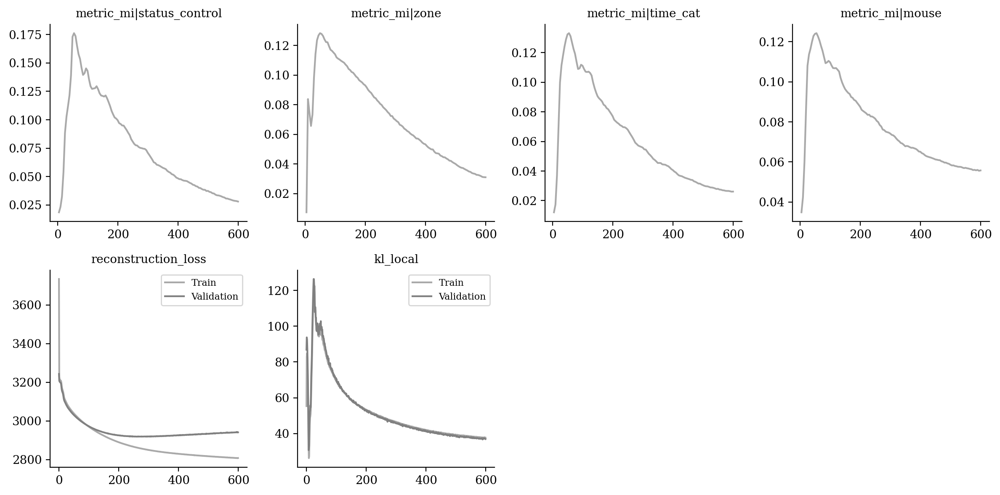

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

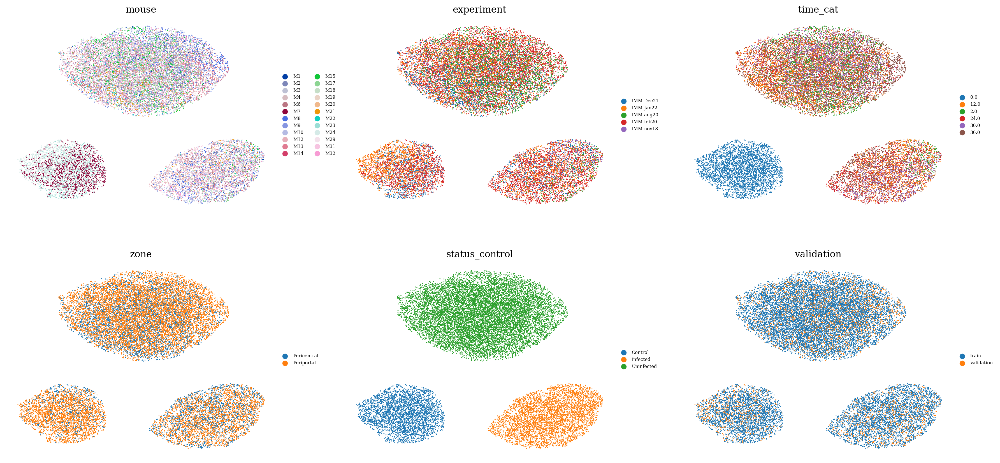

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

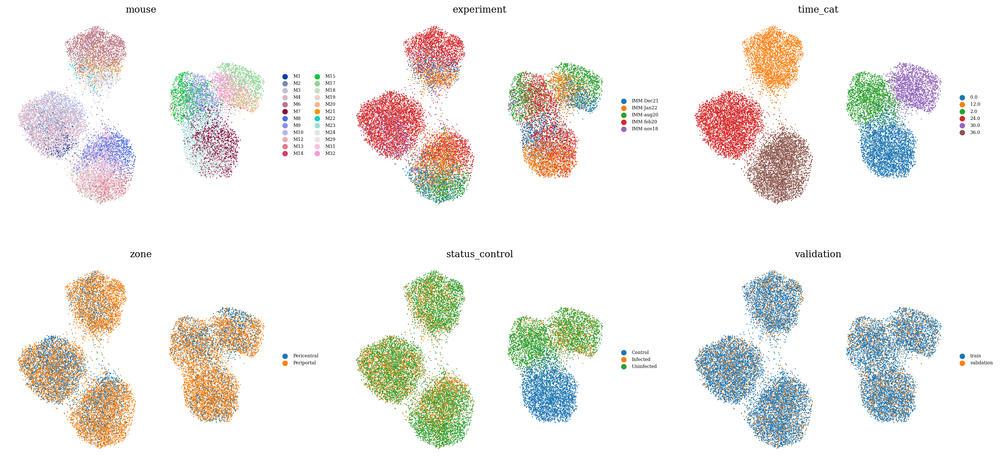

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

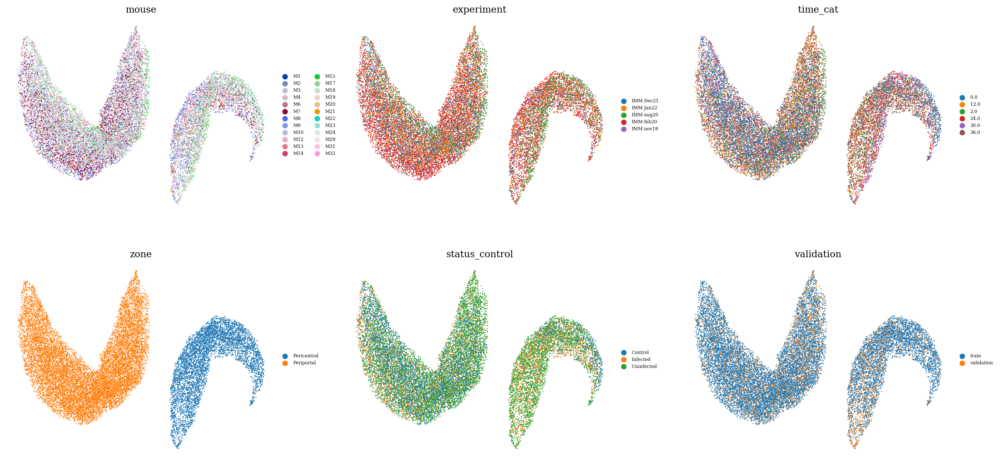

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

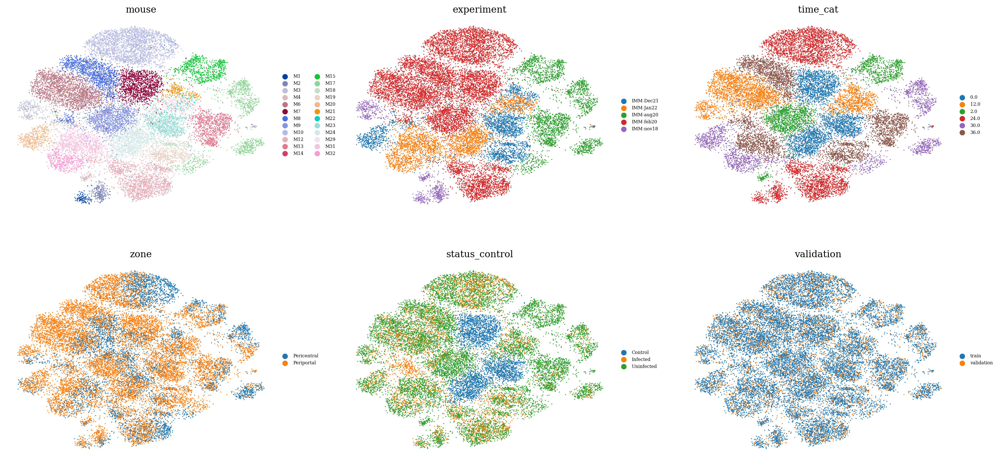

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

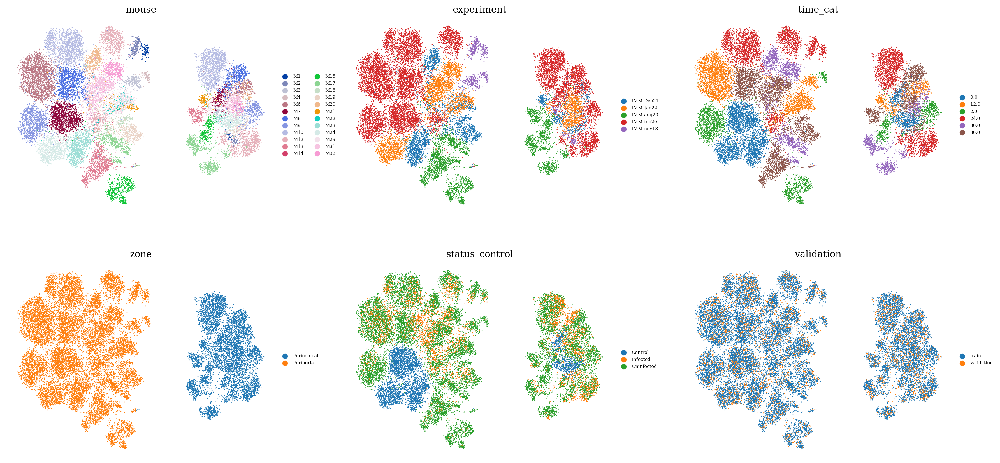

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

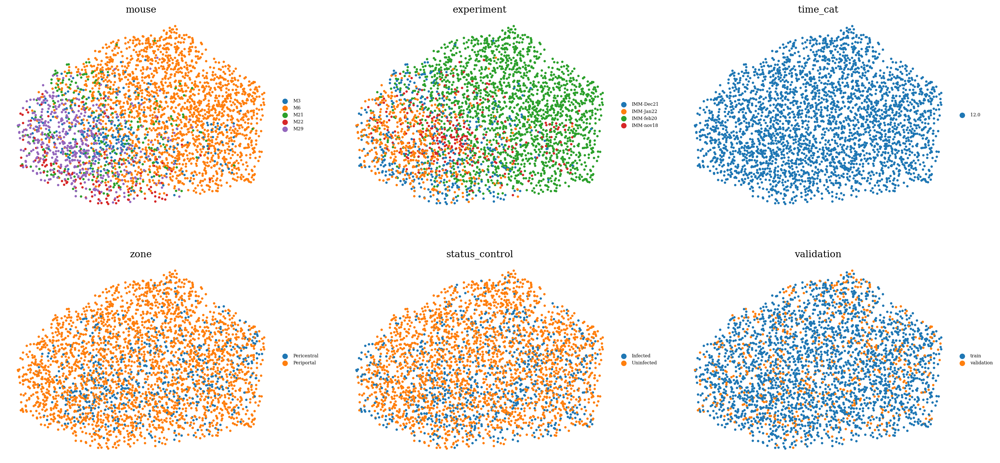

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )